<a href="https://colab.research.google.com/github/Nnalue-Emeka/Deendata/blob/main/Stress_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Downloading the stress dataset and loading the needed libraries**

In [ ]:
# installing gdown in my notebook
!pip install gdown

In [ ]:
# importing the gdown
import gdown

# File ID from Google Drive link
file_id = "1C4w3Xz8fGRFQ80kxYschsbFp95_mzlhq"
url = f"https://drive.google.com/uc?id={file_id}"

# Download the file
gdown.download(url, "Stress_file.csv", quiet=False)

Downloading...
From (original): https://drive.google.com/uc?id=1C4w3Xz8fGRFQ80kxYschsbFp95_mzlhq
From (redirected): https://drive.google.com/uc?id=1C4w3Xz8fGRFQ80kxYschsbFp95_mzlhq&confirm=t&uuid=6045eded-237a-431e-a9bb-6a86a4b6a748
To: /content/Stress_file.csv
100%|██████████| 259M/259M [00:02<00:00, 94.3MB/s]


'Stress_file.csv'

In [ ]:
#Libraries for data cleaning, preprocessing and analysis
import numpy as np # linear algebra
import pandas as pd # data processing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import LabelEncoder, LabelBinarizer, OneHotEncoder
from pandas import get_dummies
import io

# Libraries for data visulisation
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

In [ ]:
# loading the dataset
df = pd.read_csv("Stress_file.csv")
print(df.shape)
df.head()

(1048575, 18)


,BVP,EDA,TEMP,X,Y,Z,HR,Delta,Theta,Alpha1,Alpha2,Beta1,Beta2,Gamma1,Gamma2,Attention,Meditation,class
0,-0.116916,0.026215,0.778824,-0.333333,-0.003922,0.388235,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1
1,-0.107262,0.026215,0.778824,-0.349020,-0.035294,0.333333,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1
2,-0.098919,0.026215,0.778824,-0.349020,-0.035294,0.333333,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1
3,-0.092524,0.026215,0.778824,-0.380392,-0.027451,0.356863,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1
4,-0.088300,0.026215,0.778824,-0.380392,-0.027451,0.356863,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1


In [ ]:
S_df = df.copy() # Copying the dataset to preserve the original
S_df.head()

,BVP,EDA,TEMP,X,Y,Z,HR,Delta,Theta,Alpha1,Alpha2,Beta1,Beta2,Gamma1,Gamma2,Attention,Meditation,class
0,-0.116916,0.026215,0.778824,-0.333333,-0.003922,0.388235,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1
1,-0.107262,0.026215,0.778824,-0.349020,-0.035294,0.333333,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1
2,-0.098919,0.026215,0.778824,-0.349020,-0.035294,0.333333,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1
3,-0.092524,0.026215,0.778824,-0.380392,-0.027451,0.356863,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1
4,-0.088300,0.026215,0.778824,-0.380392,-0.027451,0.356863,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1


In [ ]:
S_df.columns

Index(['BVP', 'EDA', 'TEMP', 'X', 'Y', 'Z', 'HR', 'Delta', 'Theta', 'Alpha1',
       'Alpha2', 'Beta1', 'Beta2', 'Gamma1', 'Gamma2', 'Attention',
       'Meditation', 'class'],
      dtype='object')

### **Data preprocessing and Exploratory analysis of the dataset**

In [ ]:
S_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 18 columns):
 #   Column      Non-Null Count    Dtype  
---  ------      --------------    -----  
 0   BVP         1048575 non-null  float64
 1   EDA         1048575 non-null  float64
 2   TEMP        1048575 non-null  float64
 3   X           1048575 non-null  float64
 4   Y           1048575 non-null  float64
 5   Z           1048575 non-null  float64
 6   HR          1048575 non-null  float64
 7   Delta       1048575 non-null  float64
 8   Theta       1048575 non-null  float64
 9   Alpha1      1048575 non-null  float64
 10  Alpha2      1048575 non-null  float64
 11  Beta1       1048575 non-null  float64
 12  Beta2       1048575 non-null  float64
 13  Gamma1      1048575 non-null  float64
 14  Gamma2      1048575 non-null  float64
 15  Attention   1048575 non-null  float64
 16  Meditation  1048575 non-null  float64
 17  class       1048575 non-null  int64  
dtypes: float64(17), int64(

In [ ]:
S_df.describe().T

,count,mean,std,min,25%,50%,75%,max
BVP,1048575.0,-0.088337,0.043559,-1.000000,-0.101637,-0.087088,-0.074659,1.000000
EDA,1048575.0,-0.690433,0.400593,-1.000000,-0.966484,-0.878011,-0.529254,1.000000
TEMP,1048575.0,0.260472,0.438243,-0.863529,-0.007059,0.289412,0.609412,1.000000
X,1048575.0,-0.299697,0.179632,-1.000000,-0.443137,-0.333333,-0.192157,0.960784
Y,1048575.0,-0.032179,0.192736,-1.000000,-0.113725,-0.027451,0.043137,1.000000
Z,1048575.0,0.219746,0.240285,-1.000000,0.058824,0.286275,0.419608,1.000000
HR,1048575.0,0.333240,0.143449,0.000000,0.226824,0.311607,0.437808,0.889379
Delta,1048575.0,0.046431,0.065082,0.000000,0.004846,0.021823,0.061234,0.968545
Theta,1048575.0,0.042238,0.059324,0.000000,0.004638,0.019508,0.054261,0.656712
Alpha1,1048575.0,0.064931,0.088382,0.000000,0.006643,0.031595,0.089218,1.000000


In [ ]:
duplicate_rows_df = S_df[S_df.duplicated()]  # Checking for duplicates
duplicate_rows_df

,BVP,EDA,TEMP,X,Y,Z,HR,Delta,Theta,Alpha1,Alpha2,Beta1,Beta2,Gamma1,Gamma2,Attention,Meditation,class
8,-0.084989,0.026215,0.778824,-0.388235,-0.011765,0.419608,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1
3504,-0.015533,0.124001,0.764706,-0.450980,0.192157,-0.129412,0.492469,0.000596,0.088083,0.025778,0.015824,0.042393,0.079080,0.104547,0.041607,0.505051,0.767677,1
3662,-0.018949,0.111256,0.760000,-0.490196,0.254902,-0.129412,0.476759,0.019310,0.000026,0.025112,0.001560,0.014953,0.112755,0.206298,0.030956,0.464646,0.000000,1
3861,-0.079302,0.181266,0.698824,-0.333333,0.043137,0.396078,0.309400,0.066130,0.019408,0.177095,0.006959,0.189031,0.091117,0.005498,0.007589,0.747475,0.232323,1
3966,-0.079648,0.178276,0.694118,-0.333333,0.035294,0.396078,0.301870,0.017851,0.000797,0.018967,0.004318,0.469660,0.002463,0.018028,0.054832,0.040404,0.171717,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1026994,-0.074265,-0.748788,0.272941,-0.505882,-0.121569,0.043137,0.347053,0.026904,0.009082,0.115349,0.126258,0.016926,0.050411,0.089816,0.000057,0.959596,0.656566,1
1027410,-0.117099,-0.831737,0.289412,-0.458824,-0.082353,0.113725,0.515191,0.013822,0.001113,0.008737,0.041117,0.004105,0.143502,0.007214,0.068793,0.919192,0.171717,1
1034216,-0.050691,-0.704278,0.411765,-0.458824,-0.105882,0.200000,0.244742,0.026828,0.000080,0.047180,0.004370,0.000700,0.004206,0.072001,0.100768,0.777778,0.202020,1
1034626,-0.097980,-0.698614,0.411765,-0.427451,-0.066667,0.066667,0.240197,0.000588,0.061730,0.042239,0.000384,0.011066,0.019903,0.000567,0.047651,0.202020,0.020202,1


In [ ]:
# Delete duplicate rows

S_df.drop_duplicates(inplace=True)
print(S_df.shape)
S_df.head()


(1047330, 18)


,BVP,EDA,TEMP,X,Y,Z,HR,Delta,Theta,Alpha1,Alpha2,Beta1,Beta2,Gamma1,Gamma2,Attention,Meditation,class
0,-0.116916,0.026215,0.778824,-0.333333,-0.003922,0.388235,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1
1,-0.107262,0.026215,0.778824,-0.349020,-0.035294,0.333333,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1
2,-0.098919,0.026215,0.778824,-0.349020,-0.035294,0.333333,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1
3,-0.092524,0.026215,0.778824,-0.380392,-0.027451,0.356863,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1
4,-0.088300,0.026215,0.778824,-0.380392,-0.027451,0.356863,0.357959,0.019138,0.082949,0.017362,0.020516,0.001465,0.002844,0.021253,0.044376,0.484848,0.090909,1


In [ ]:
S_df.nunique() # Number of Unique values in each of the columns

,0
BVP,65736
EDA,21306
TEMP,384
X,207
Y,205
Z,240
HR,2943
Delta,15275
Theta,15310
Alpha1,15259


In [ ]:
# Check for infinite values
infinite_values = np.isinf(S_df).any()
# Check for missing values
missing_values = np.isnan(S_df).any()

In [ ]:
missing_values

,0
BVP,False
EDA,False
TEMP,False
X,False
Y,False
Z,False
HR,False
Delta,False
Theta,False
Alpha1,False


In [ ]:
infinite_values

,0
BVP,False
EDA,False
TEMP,False
X,False
Y,False
Z,False
HR,False
Delta,False
Theta,False
Alpha1,False


# **Feature Engineering**

In [ ]:
S_df['Alpha'] = (S_df['Alpha1']+ S_df['Alpha2'])/2
S_df['Beta'] = (S_df['Beta1'] + S_df['Beta2'])/2
S_df['Gamma'] = (S_df['Gamma1'] + S_df['Gamma2'])/2

In [ ]:
S_df = S_df.drop(['Beta1', 'Beta2', 'Alpha1', 'Alpha2', 'Gamma1', 'Gamma2'], axis=1)
print(S_df.shape)
S_df.head()

(1047330, 15)


,BVP,EDA,TEMP,X,Y,Z,HR,Delta,Theta,Attention,Meditation,class,Alpha,Beta,Gamma
0,-0.116916,0.026215,0.778824,-0.333333,-0.003922,0.388235,0.357959,0.019138,0.082949,0.484848,0.090909,1,0.018939,0.002154,0.032814
1,-0.107262,0.026215,0.778824,-0.349020,-0.035294,0.333333,0.357959,0.019138,0.082949,0.484848,0.090909,1,0.018939,0.002154,0.032814
2,-0.098919,0.026215,0.778824,-0.349020,-0.035294,0.333333,0.357959,0.019138,0.082949,0.484848,0.090909,1,0.018939,0.002154,0.032814
3,-0.092524,0.026215,0.778824,-0.380392,-0.027451,0.356863,0.357959,0.019138,0.082949,0.484848,0.090909,1,0.018939,0.002154,0.032814
4,-0.088300,0.026215,0.778824,-0.380392,-0.027451,0.356863,0.357959,0.019138,0.082949,0.484848,0.090909,1,0.018939,0.002154,0.032814


In [ ]:
# Calculate the magnitude of acceleration for each row
S_df['Mag_Acc'] = np.sqrt(S_df['X']**2 + S_df['Y']**2 + S_df['Z']**2).to_frame()

In [ ]:
S_df['Total_Power'] = S_df['Gamma'] + S_df['Alpha'] + S_df['Theta'] + S_df['Beta']

In [ ]:
S_df['Gamma_ratio'] = S_df['Gamma']/S_df['Total_Power']
S_df['Alpha_ratio'] = S_df['Alpha']/S_df['Total_Power']
S_df['Theta_ratio'] = S_df['Theta']/S_df['Total_Power']
S_df['beta_ratio'] = S_df['Beta']/S_df['Total_Power']

In [ ]:
# Calculate Average_Power_EEG
S_df['Average_Power_EEG'] = S_df[['Gamma', 'Alpha', 'Theta', 'Beta']].mean(axis=1)

In [ ]:
S_df['Alpha_Theta_Ratio'] = S_df['Alpha'] / S_df['Theta']
S_df['Beta_Minus_Alpha'] = S_df['Beta'] - S_df['Alpha']

In [ ]:
S_df.head()

,BVP,EDA,TEMP,X,Y,Z,HR,Delta,Theta,Attention,...,Gamma,Mag_Acc,Total_Power,Gamma_ratio,Alpha_ratio,Theta_ratio,beta_ratio,Average_Power_EEG,Alpha_Theta_Ratio,Beta_Minus_Alpha
0,-0.116916,0.026215,0.778824,-0.333333,-0.003922,0.388235,0.357959,0.019138,0.082949,0.484848,...,0.032814,0.511716,0.136857,0.239772,0.138385,0.606102,0.015741,0.034214,0.22832,-0.016785
1,-0.107262,0.026215,0.778824,-0.349020,-0.035294,0.333333,0.357959,0.019138,0.082949,0.484848,...,0.032814,0.483913,0.136857,0.239772,0.138385,0.606102,0.015741,0.034214,0.22832,-0.016785
2,-0.098919,0.026215,0.778824,-0.349020,-0.035294,0.333333,0.357959,0.019138,0.082949,0.484848,...,0.032814,0.483913,0.136857,0.239772,0.138385,0.606102,0.015741,0.034214,0.22832,-0.016785
3,-0.092524,0.026215,0.778824,-0.380392,-0.027451,0.356863,0.357959,0.019138,0.082949,0.484848,...,0.032814,0.522305,0.136857,0.239772,0.138385,0.606102,0.015741,0.034214,0.22832,-0.016785
4,-0.088300,0.026215,0.778824,-0.380392,-0.027451,0.356863,0.357959,0.019138,0.082949,0.484848,...,0.032814,0.522305,0.136857,0.239772,0.138385,0.606102,0.015741,0.034214,0.22832,-0.016785


In [ ]:
# Check for infinite values
infinite_values = np.isinf(S_df).any()
# Check for missing values
missing_values = np.isnan(S_df).any()

In [ ]:
infinite_values

,0
BVP,False
EDA,False
TEMP,False
X,False
Y,False
Z,False
HR,False
Delta,False
Theta,False
Attention,False


In [ ]:
missing_values

,0
BVP,False
EDA,False
TEMP,False
X,False
Y,False
Z,False
HR,False
Delta,False
Theta,False
Attention,False


In [ ]:
S_df_cleaned = S_df[~np.isinf(S_df).any(axis=1)]

In [ ]:
# Verify no infinite values remain
infinite_values_after_cleaning = np.isinf(S_df_cleaned).any().any()
print(f"Infinite values after cleaning: {infinite_values_after_cleaning}")

Infinite values after cleaning: False


In [ ]:
print(S_df_cleaned.shape)

(1046180, 24)


In [ ]:
from sklearn.feature_selection import mutual_info_classif

Gamma                0.673733
Average_Power_EEG    0.673730
Total_Power          0.673726
beta_ratio           0.673725
Alpha_ratio          0.673717
Gamma_ratio          0.673715
Beta                 0.673705
Theta_ratio          0.673680
Alpha                0.673670
Beta_Minus_Alpha     0.673659
Alpha_Theta_Ratio    0.668816
Theta                0.651969
Delta                0.648164
EDA                  0.508349
TEMP                 0.206405
HR                   0.167034
Mag_Acc              0.069279
Z                    0.046973
Y                    0.044275
X                    0.028165
Meditation           0.010361
BVP                  0.009229
Attention            0.008726
Name: MI Scores, dtype: float64


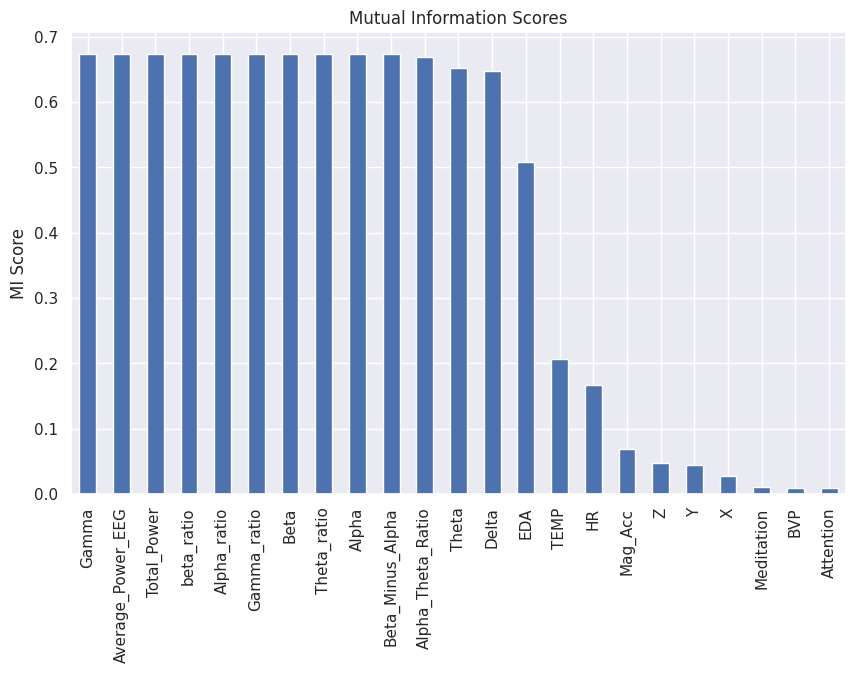

In [ ]:
# Assuming 'df' is your DataFrame, with columns as features and 'target' as your label column
X = S_df_cleaned.drop('class', axis=1)  # Features
y = S_df_cleaned['class']  # Target variable

# Compute mutual information scores
mi_scores = mutual_info_classif(X, y, discrete_features=False, random_state=0)

# Create a Series with MI scores, indexed by feature names
mi_scores = pd.Series(mi_scores, name="MI Scores", index=X.columns)

# Sort the scores in descending order
mi_scores = mi_scores.sort_values(ascending=False)

# Display the scores
print(mi_scores)

# Optionally, visualize
import matplotlib.pyplot as plt
mi_scores.plot.bar(figsize=(10, 6))
plt.title('Mutual Information Scores')
plt.ylabel('MI Score')
plt.show()

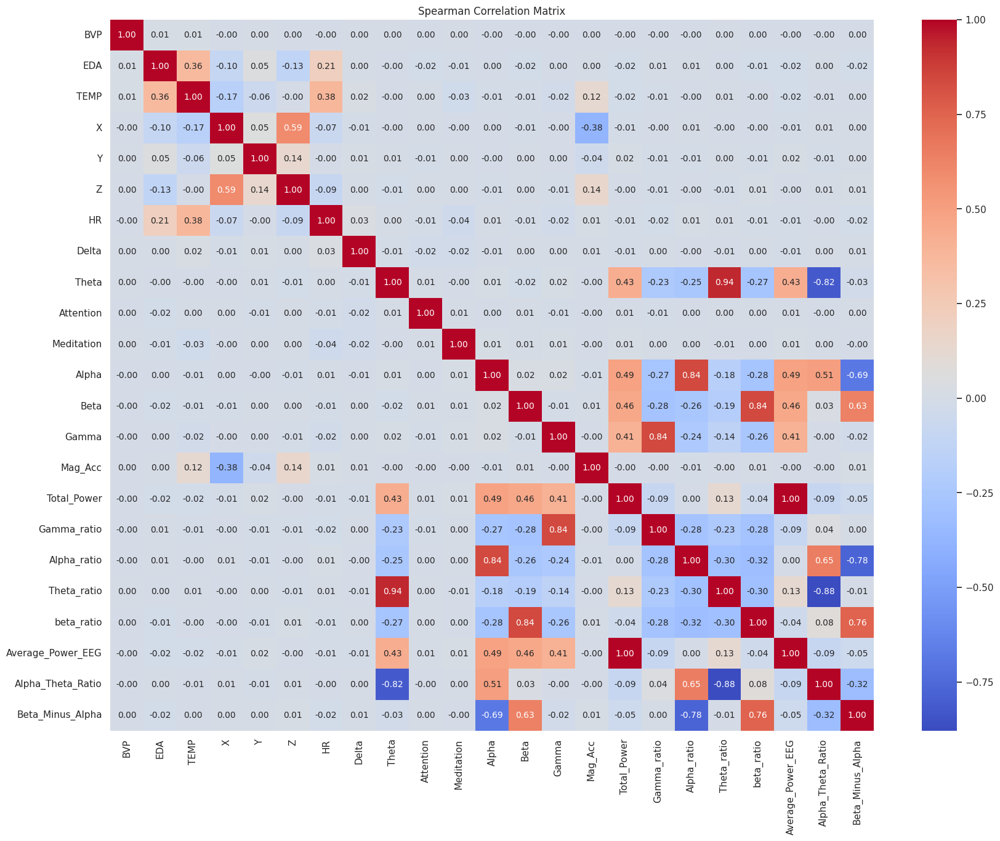

In [ ]:
# Calculate Spearman correlation matrix
corr_matrix = X.corr(method='spearman')

plt.figure(figsize=(20,15))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', annot_kws={"size": 10})

# Add labels and title
plt.title('Spearman Correlation Matrix')
plt.show()

In [ ]:
f_df = S_df_cleaned[['BVP', 'EDA', 'TEMP', 'HR', 'Mag_Acc', 'X', 'Y', 'Z', 'Average_Power_EEG', 'Gamma',
             'Alpha', 'Theta', 'Beta', 'Gamma_ratio', 'Alpha_ratio', 'beta_ratio', 'Attention', 'Meditation', 'Alpha_Theta_Ratio', 'Beta_Minus_Alpha','class']]
print(f_df.shape)
f_df.head()

(1046180, 21)


,BVP,EDA,TEMP,HR,Mag_Acc,X,Y,Z,Average_Power_EEG,Gamma,...,Theta,Beta,Gamma_ratio,Alpha_ratio,beta_ratio,Attention,Meditation,Alpha_Theta_Ratio,Beta_Minus_Alpha,class
0,-0.116916,0.026215,0.778824,0.357959,0.511716,-0.333333,-0.003922,0.388235,0.034214,0.032814,...,0.082949,0.002154,0.239772,0.138385,0.015741,0.484848,0.090909,0.22832,-0.016785,1
1,-0.107262,0.026215,0.778824,0.357959,0.483913,-0.349020,-0.035294,0.333333,0.034214,0.032814,...,0.082949,0.002154,0.239772,0.138385,0.015741,0.484848,0.090909,0.22832,-0.016785,1
2,-0.098919,0.026215,0.778824,0.357959,0.483913,-0.349020,-0.035294,0.333333,0.034214,0.032814,...,0.082949,0.002154,0.239772,0.138385,0.015741,0.484848,0.090909,0.22832,-0.016785,1
3,-0.092524,0.026215,0.778824,0.357959,0.522305,-0.380392,-0.027451,0.356863,0.034214,0.032814,...,0.082949,0.002154,0.239772,0.138385,0.015741,0.484848,0.090909,0.22832,-0.016785,1
4,-0.088300,0.026215,0.778824,0.357959,0.522305,-0.380392,-0.027451,0.356863,0.034214,0.032814,...,0.082949,0.002154,0.239772,0.138385,0.015741,0.484848,0.090909,0.22832,-0.016785,1


In [ ]:
f_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1046180 entries, 0 to 1048574
Data columns (total 21 columns):
 #   Column             Non-Null Count    Dtype  
---  ------             --------------    -----  
 0   BVP                1046180 non-null  float64
 1   EDA                1046180 non-null  float64
 2   TEMP               1046180 non-null  float64
 3   HR                 1046180 non-null  float64
 4   Mag_Acc            1046180 non-null  float64
 5   X                  1046180 non-null  float64
 6   Y                  1046180 non-null  float64
 7   Z                  1046180 non-null  float64
 8   Average_Power_EEG  1046180 non-null  float64
 9   Gamma              1046180 non-null  float64
 10  Alpha              1046180 non-null  float64
 11  Theta              1046180 non-null  float64
 12  Beta               1046180 non-null  float64
 13  Gamma_ratio        1046180 non-null  float64
 14  Alpha_ratio        1046180 non-null  float64
 15  beta_ratio         1046180 non-null  

In [ ]:
# Check for infinite values
infinite_values2 = np.isinf(f_df).any()
# Check for missing values
missing_values2 = np.isnan(f_df).any()

In [ ]:
infinite_values2

,0
BVP,False
EDA,False
TEMP,False
HR,False
Mag_Acc,False
X,False
Y,False
Z,False
Average_Power_EEG,False
Gamma,False


In [ ]:
target_column = 'class'
feature_columns = [col for col in f_df.columns if col != target_column]

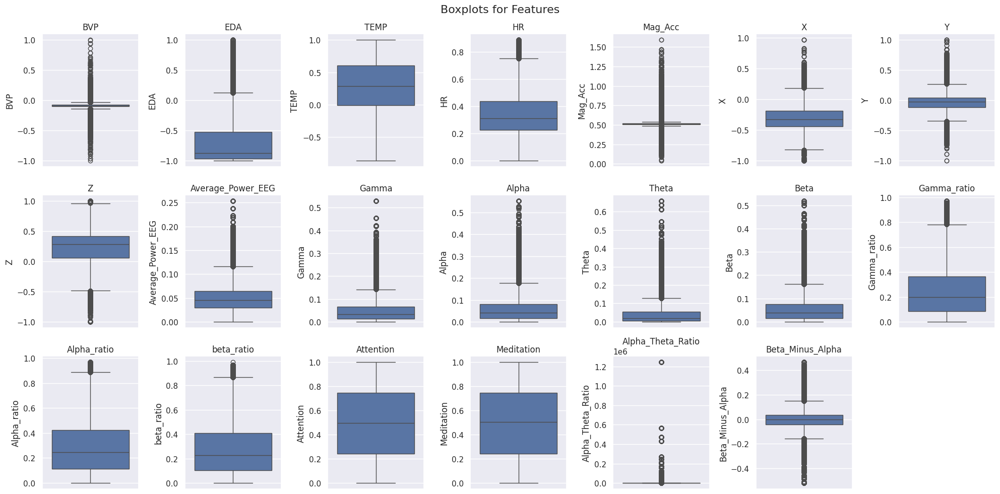

In [ ]:
target_column = 'class'
feature_columns = [col for col in f_df.columns if col != target_column]

# Calculate the number of rows and columns for subplot grid
n_cols = 7  # You can adjust this based on how many plots you want per row
n_rows = int(np.ceil(len(feature_columns) / n_cols))

# Create a figure and an array of axes
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 10))
fig.suptitle('Boxplots for Features', fontsize=16)

# Flatten the axes array if it's 2D for easier indexing
axes = axes.flatten() if isinstance(axes, np.ndarray) else [axes]

# Plot boxplots
for i, column in enumerate(feature_columns):
    sns.boxplot(data=f_df[column], ax=axes[i], showfliers=True)  # showfliers=True to show outliers
    axes[i].set_title(column)
    axes[i].set_xlabel('')

# Remove unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

In [ ]:
print(f_df.shape)

(1046180, 21)


In [ ]:
print(f_df.dtypes)

BVP                  float64
EDA                  float64
TEMP                 float64
HR                   float64
Mag_Acc              float64
X                    float64
Y                    float64
Z                    float64
Average_Power_EEG    float64
Gamma                float64
Alpha                float64
Theta                float64
Beta                 float64
Gamma_ratio          float64
Alpha_ratio          float64
beta_ratio           float64
Attention            float64
Meditation           float64
Alpha_Theta_Ratio    float64
Beta_Minus_Alpha     float64
class                  int64
dtype: object


In [ ]:
print(f_df.columns)
print(feature_columns)

Index(['BVP', 'EDA', 'TEMP', 'HR', 'Mag_Acc', 'X', 'Y', 'Z',
       'Average_Power_EEG', 'Gamma', 'Alpha', 'Theta', 'Beta', 'Gamma_ratio',
       'Alpha_ratio', 'beta_ratio', 'Attention', 'Meditation',
       'Alpha_Theta_Ratio', 'Beta_Minus_Alpha', 'class'],
      dtype='object')
['BVP', 'EDA', 'TEMP', 'HR', 'Mag_Acc', 'X', 'Y', 'Z', 'Average_Power_EEG', 'Gamma', 'Alpha', 'Theta', 'Beta', 'Gamma_ratio', 'Alpha_ratio', 'beta_ratio', 'Attention', 'Meditation', 'Alpha_Theta_Ratio', 'Beta_Minus_Alpha']


In [ ]:
unique_counts = f_df.nunique()
print(unique_counts)

BVP                  65699
EDA                  21294
TEMP                   384
HR                    2942
Mag_Acc              69384
X                      207
Y                      205
Z                      240
Average_Power_EEG    15870
Gamma                15870
Alpha                15870
Theta                15309
Beta                 15870
Gamma_ratio          15870
Alpha_ratio          15870
beta_ratio           15870
Attention              100
Meditation             100
Alpha_Theta_Ratio    15870
Beta_Minus_Alpha     15870
class                    2
dtype: int64


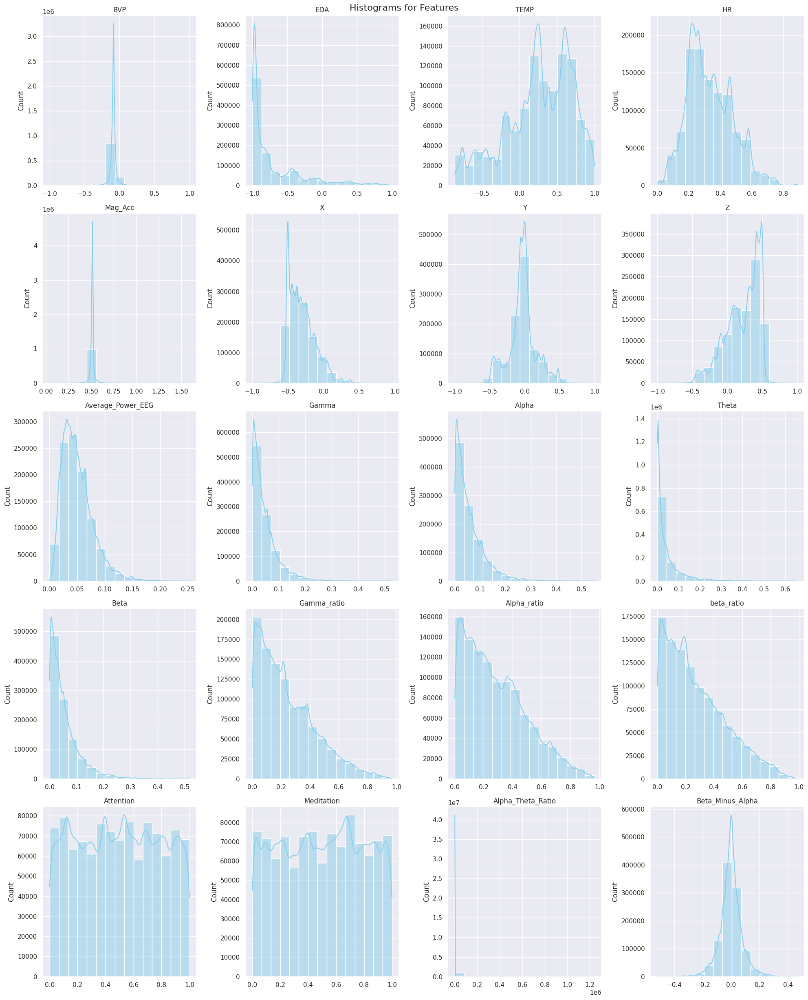

In [ ]:
n_cols = 4  # Number of columns in the subplot grid
n_rows = int(np.ceil(len(feature_columns) / n_cols))  # Calculate number of rows needed

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 5*n_rows))
fig.suptitle('Histograms for Features', fontsize=16)
axes = axes.flatten()

for i, column in enumerate(feature_columns):
    if f_df[column].nunique() > 1:  # Only plot if there's more than one unique value
        sns.histplot(data=f_df, x=column, kde=True, ax=axes[i], bins=15, color="skyblue")
        axes[i].set_title(column)
        axes[i].set_xlabel('')
    else:
        print(f"Skipping {column} as it has only one unique value.")
        fig.delaxes(axes[i])  # Remove the subplot if we can't plot

# Remove any extra subplot axes that were created but not used
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

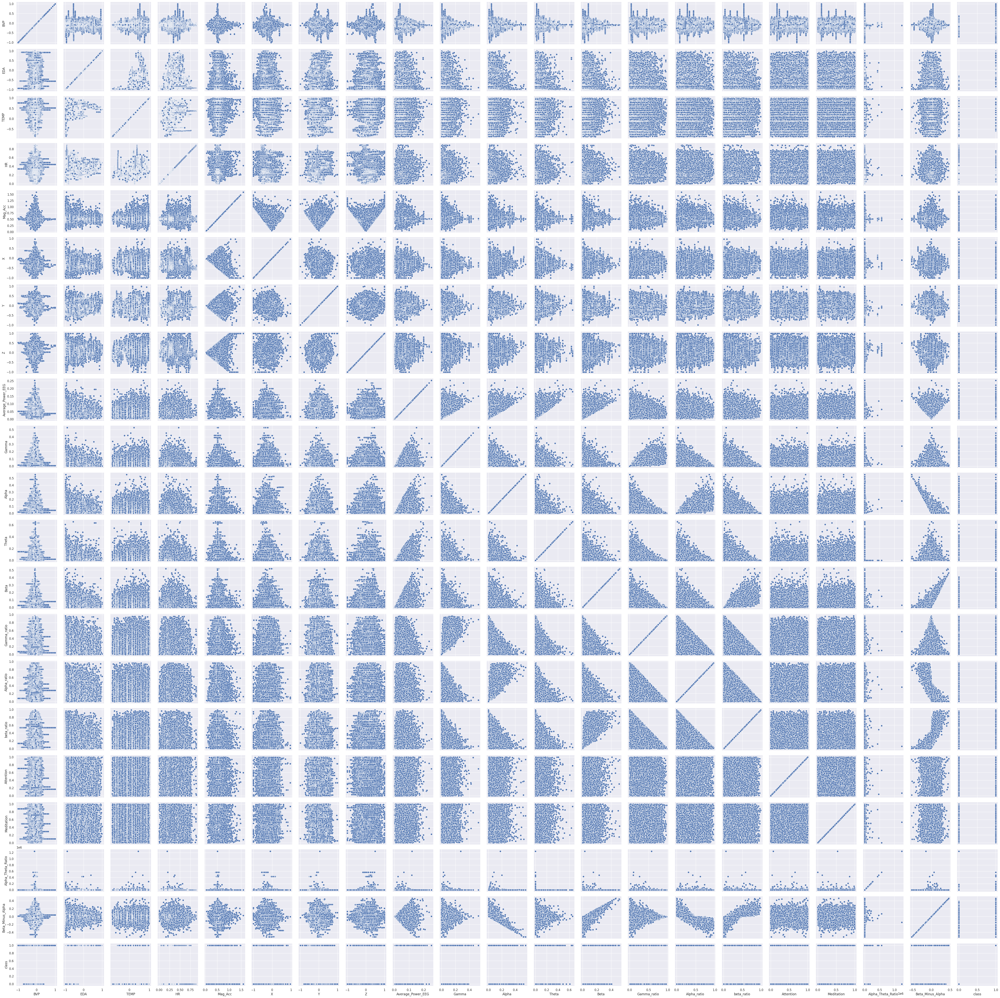

In [ ]:
# Create a grid of subplots
g = sns.PairGrid(f_df)

# Map the scatterplot function to each subplot
g.map(sns.scatterplot)

# Show the plot
plt.show()

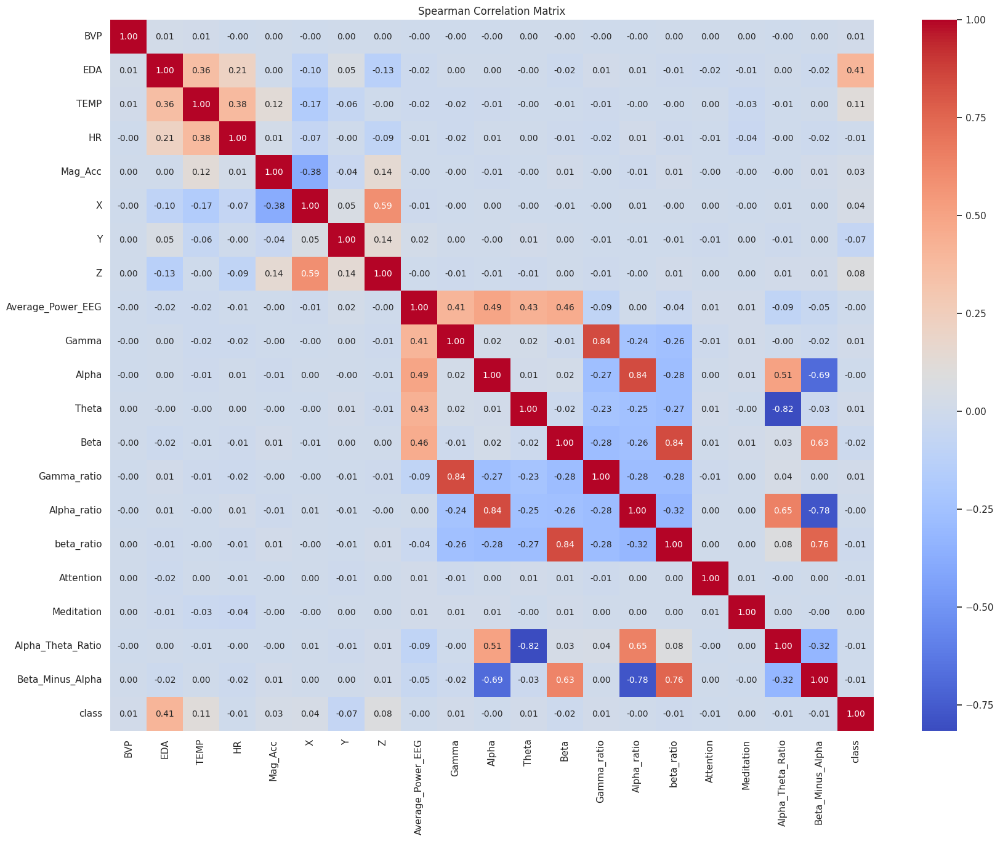

In [ ]:
# Calculate Spearman correlation matrix
corr_matrix = f_df.corr(method='spearman')

plt.figure(figsize=(20,15))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', annot_kws={"size": 10})

# Add labels and title
plt.title('Spearman Correlation Matrix')
plt.show()

In [ ]:
f_df2 = f_df.copy()

In [ ]:
f_df2.describe().T

,count,mean,std,min,25%,50%,75%,max
BVP,1046180.0,-0.088337,0.043575,-1.000000e+00,-0.101648,-0.087093,-0.074648,1.000000e+00
EDA,1046180.0,-0.690287,0.400647,-1.000000e+00,-0.966484,-0.877862,-0.528968,1.000000e+00
TEMP,1046180.0,0.260658,0.438161,-8.635294e-01,-0.007059,0.289412,0.609412,1.000000e+00
HR,1046180.0,0.333294,0.143433,0.000000e+00,0.226824,0.311607,0.437938,8.893794e-01
Mag_Acc,1046180.0,0.515024,0.032421,4.056502e-02,0.507612,0.515071,0.521008,1.591418e+00
X,1046180.0,-0.299731,0.179623,-1.000000e+00,-0.443137,-0.333333,-0.192157,9.607843e-01
Y,1046180.0,-0.032237,0.192686,-1.000000e+00,-0.113725,-0.027451,0.043137,1.000000e+00
Z,1046180.0,0.219803,0.240244,-1.000000e+00,0.058824,0.286275,0.419608,1.000000e+00
Average_Power_EEG,1046180.0,0.050451,0.027523,4.389183e-04,0.030213,0.045602,0.064669,2.528962e-01
Gamma,1046180.0,0.047193,0.046990,6.292867e-06,0.013858,0.032979,0.065224,5.284058e-01


In [ ]:
def detect_outliers_iqr(dataframe, column):

    Q1 = dataframe[column].quantile(0.25)
    Q3 = dataframe[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 0.5 * IQR
    upper_bound = Q3 + 0.5 * IQR
    outliers = (dataframe[column] < lower_bound) | (dataframe[column] > upper_bound)
    return outliers

# Assuming 'f_df' is your DataFrame and you want to check for outliers in all columns except 'class'
columns_to_check = [col for col in f_df2.columns if col != 'class']

# Dictionary to store outliers for each column
outliers_dict = {}

for column in columns_to_check:
    outliers = detect_outliers_iqr(f_df2, column)
    outliers_dict[column] = outliers
    print(f"Number of outliers in {column}: {outliers.sum()}")

    # Optionally, to see which rows are outliers
    outlier_rows = f_df2[outliers]
    print(f"Rows with outliers in {column}:")
    print(outlier_rows[[column]].head())  # Show first few rows with outliers for this column


Number of outliers in BVP: 286214
Rows with outliers in BVP:
         BVP
0  -0.116916
36 -0.045933
37 -0.028146
38 -0.011309
39  0.003061
Number of outliers in EDA: 153583
Rows with outliers in EDA:
        EDA
0  0.026215
1  0.026215
2  0.026215
3  0.026215
4  0.026215
Number of outliers in TEMP: 155130
Rows with outliers in TEMP:
            TEMP
130560 -0.383529
130561 -0.383529
130562 -0.383529
130563 -0.383529
130564 -0.383529
Number of outliers in HR: 146416
Rows with outliers in HR:
             HR
11520  0.597247
11521  0.597247
11522  0.597247
11523  0.597247
11524  0.597247
Number of outliers in Mag_Acc: 259622
Rows with outliers in Mag_Acc:
    Mag_Acc
1  0.483913
2  0.483913
5  0.582442
6  0.582442
7  0.571783
Number of outliers in X: 128659
Rows with outliers in X:
            X
211 -0.670588
212 -0.670588
213 -0.749020
214 -0.749020
215 -0.639216
Number of outliers in Y: 332931
Rows with outliers in Y:
            Y
193  0.145098
194  0.145098
195  0.129412
196  0.129412

In [ ]:
for column, outliers in outliers_dict.items():
    f_df2 = f_df2[~outliers]  # Keep only the rows where the value is not an outlier

print(f"Shape of DataFrame after removing outliers: {f_df2.shape}")

<ipython-input-41-72b9e384506a>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  f_df2 = f_df2[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-41-72b9e384506a>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  f_df2 = f_df2[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-41-72b9e384506a>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  f_df2 = f_df2[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-41-72b9e384506a>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  f_df2 = f_df2[~outliers]  # Keep only the rows where the value is not an outlier


Shape of DataFrame after removing outliers: (70102, 21)


<ipython-input-41-72b9e384506a>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  f_df2 = f_df2[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-41-72b9e384506a>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  f_df2 = f_df2[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-41-72b9e384506a>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  f_df2 = f_df2[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-41-72b9e384506a>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  f_df2 = f_df2[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-41-72b9e384506a>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  f_df2 = f_df2[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-41-72b9e384506a

In [ ]:
target1_column = 'class'
feature1_columns = [col for col in f_df2.columns if col != target1_column]

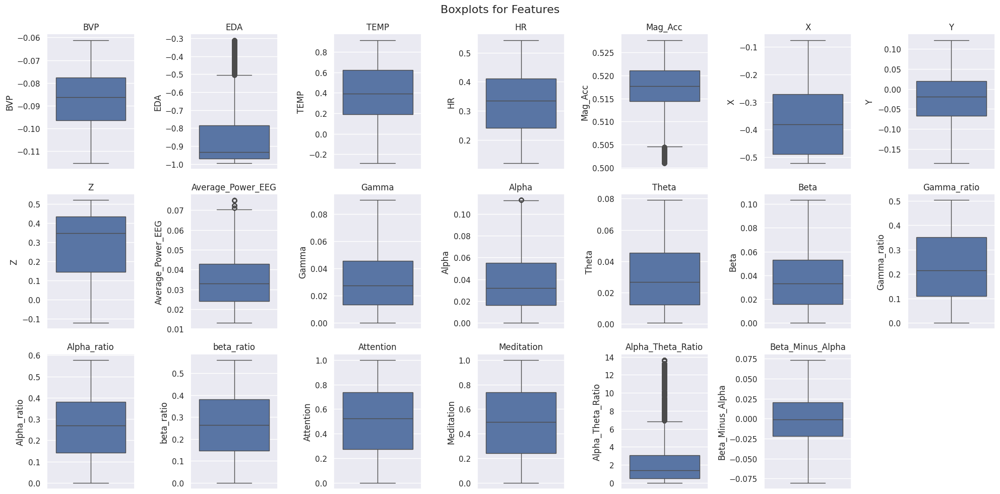

In [ ]:
target1_column = 'class'
feature1_columns = [col for col in f_df2.columns if col != target1_column]

# Calculate the number of rows and columns for subplot grid
n_cols = 7  # You can adjust this based on how many plots you want per row
n_rows = int(np.ceil(len(feature_columns) / n_cols))

# Create a figure and an array of axes
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 10))
fig.suptitle('Boxplots for Features', fontsize=16)

# Flatten the axes array if it's 2D for easier indexing
axes = axes.flatten() if isinstance(axes, np.ndarray) else [axes]

# Plot boxplots
for i, column in enumerate(feature1_columns):
    sns.boxplot(data=f_df2[column], ax=axes[i], showfliers=True)  # showfliers=True to show outliers
    axes[i].set_title(column)
    axes[i].set_xlabel('')

# Remove unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

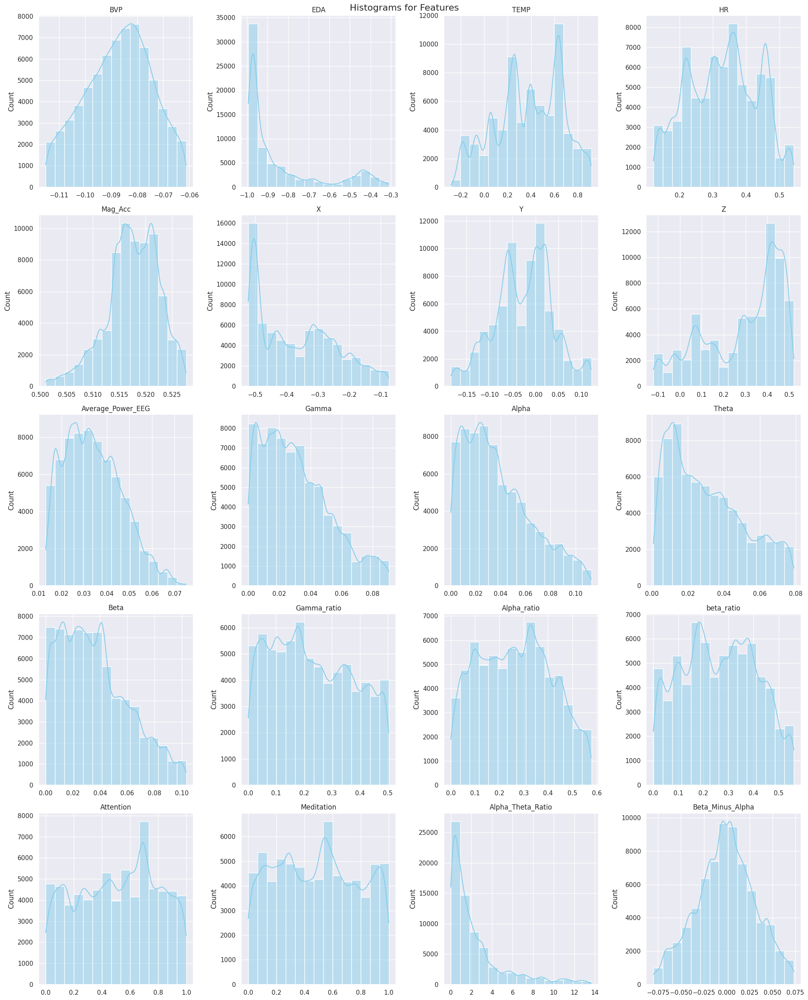

In [ ]:
n_cols = 4  # Number of columns in the subplot grid
n_rows = int(np.ceil(len(feature1_columns) / n_cols))  # Calculate number of rows needed

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 5*n_rows))
fig.suptitle('Histograms for Features', fontsize=16)
axes = axes.flatten()

for i, column in enumerate(feature1_columns):
    if f_df2[column].nunique() > 1:  # Only plot if there's more than one unique value
        sns.histplot(data=f_df2, x=column, kde=True, ax=axes[i], bins=15, color="skyblue")
        axes[i].set_title(column)
        axes[i].set_xlabel('')
    else:
        print(f"Skipping {column} as it has only one unique value.")
        fig.delaxes(axes[i])  # Remove the subplot if we can't plot

# Remove any extra subplot axes that were created but not used
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

# Building a model

In [ ]:
pip install xgboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.9/153.9 MB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 201.3/201.3 MB 2.1 MB/s eta 0:00:00


In [ ]:
pip install imblearn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 238.4/238.4 kB 6.5 MB/s eta 0:00:00


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import precision_recall_fscore_support as score
from sklearn.model_selection import learning_curve, validation_curve
from sklearn import metrics
from sklearn.preprocessing import RobustScaler
# import train_test_split so we can split our data into train and test
from sklearn.model_selection import train_test_split

# import the LogReg model from sklearn
from sklearn.linear_model import LogisticRegression
# import the 'metrics' module, which includes important metrics we may want to use
from sklearn import metrics
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix, precision_recall_fscore_support, precision_score, recall_score, roc_auc_score
from sklearn.preprocessing import label_binarize
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier
from sklearn.datasets import make_classification
import tensorflow as tf
import keras
import xgboost as xgb
from imblearn.over_sampling import SMOTE
from sklearn.datasets import make_classification
from collections import Counter
from sklearn.feature_selection import RFE
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from scipy.stats import randint


In [ ]:
feature_cols = f_df2.columns[:-1]
feature_cols

Index(['BVP', 'EDA', 'TEMP', 'HR', 'Mag_Acc', 'X', 'Y', 'Z',
       'Average_Power_EEG', 'Gamma', 'Alpha', 'Theta', 'Beta', 'Gamma_ratio',
       'Alpha_ratio', 'beta_ratio', 'Attention', 'Meditation',
       'Alpha_Theta_Ratio', 'Beta_Minus_Alpha'],
      dtype='object')

In [ ]:
X_df = f_df2.drop('class', axis=1)  # Features
X_df.head()

,BVP,EDA,TEMP,HR,Mag_Acc,X,Y,Z,Average_Power_EEG,Gamma,Alpha,Theta,Beta,Gamma_ratio,Alpha_ratio,beta_ratio,Attention,Meditation,Alpha_Theta_Ratio,Beta_Minus_Alpha
50080,-0.103857,-0.498046,0.268235,0.543365,0.508218,-0.490196,-0.129412,-0.035294,0.031806,0.006440,0.037751,0.016385,0.066648,0.050619,0.29673,0.523860,0.757576,0.333333,2.303963,0.028897
50109,-0.074291,-0.485069,0.268235,0.543365,0.525827,-0.521569,-0.003922,0.066667,0.031806,0.006440,0.037751,0.016385,0.066648,0.050619,0.29673,0.523860,0.757576,0.333333,2.303963,0.028897
50110,-0.077812,-0.485069,0.268235,0.543365,0.525827,-0.521569,-0.003922,0.066667,0.031806,0.006440,0.037751,0.016385,0.066648,0.050619,0.29673,0.523860,0.757576,0.333333,2.303963,0.028897
50602,-0.063105,-0.491048,0.280000,0.526227,0.521952,-0.498039,0.121569,-0.098039,0.020929,0.004425,0.001100,0.040214,0.037979,0.052854,0.01314,0.453657,0.222222,0.757576,0.027355,0.036879
50603,-0.067848,-0.491048,0.280000,0.526227,0.511716,-0.490196,0.121569,-0.082353,0.020929,0.004425,0.001100,0.040214,0.037979,0.052854,0.01314,0.453657,0.222222,0.757576,0.027355,0.036879


In [ ]:
target = f_df2['class'] # Target Dataset
target

,class
50080,0
50109,0
50110,0
50602,0
50603,0
...,...
1047262,1
1047263,1
1047264,1
1047471,1


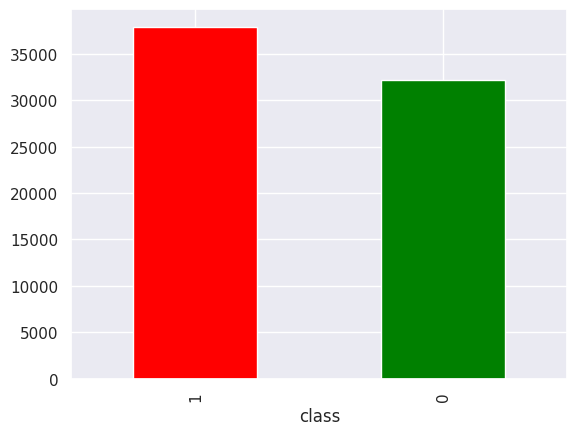

In [ ]:
target.value_counts().plot.bar(color=['red', 'green']) # Checking for whether the target variable is unbalance or not
fname12 = "Unbalance.png"
plt.savefig(fname12, bbox_inches='tight', dpi=100)

In [ ]:
# SMOTE algorithm to balance the dataset

sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X_df, target)

# After applying SMOTE
print('Resampled dataset shape %s' % Counter(y_res))

Resampled dataset shape Counter({0: 37922, 1: 37922})


<Axes: xlabel='class'>

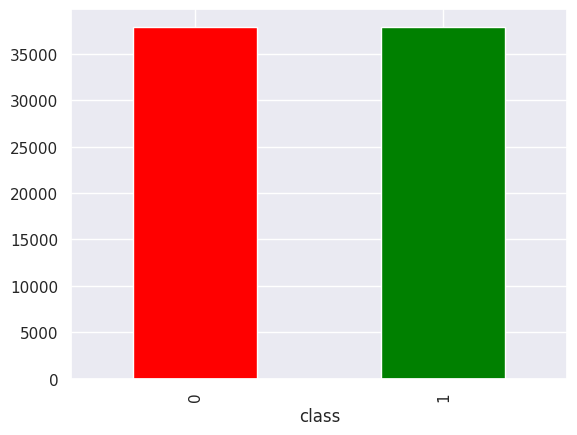

In [ ]:
y_res.value_counts().plot.bar(color=['red', 'green']) # Checking for whether the target variable is unbalance or not

<Axes: >

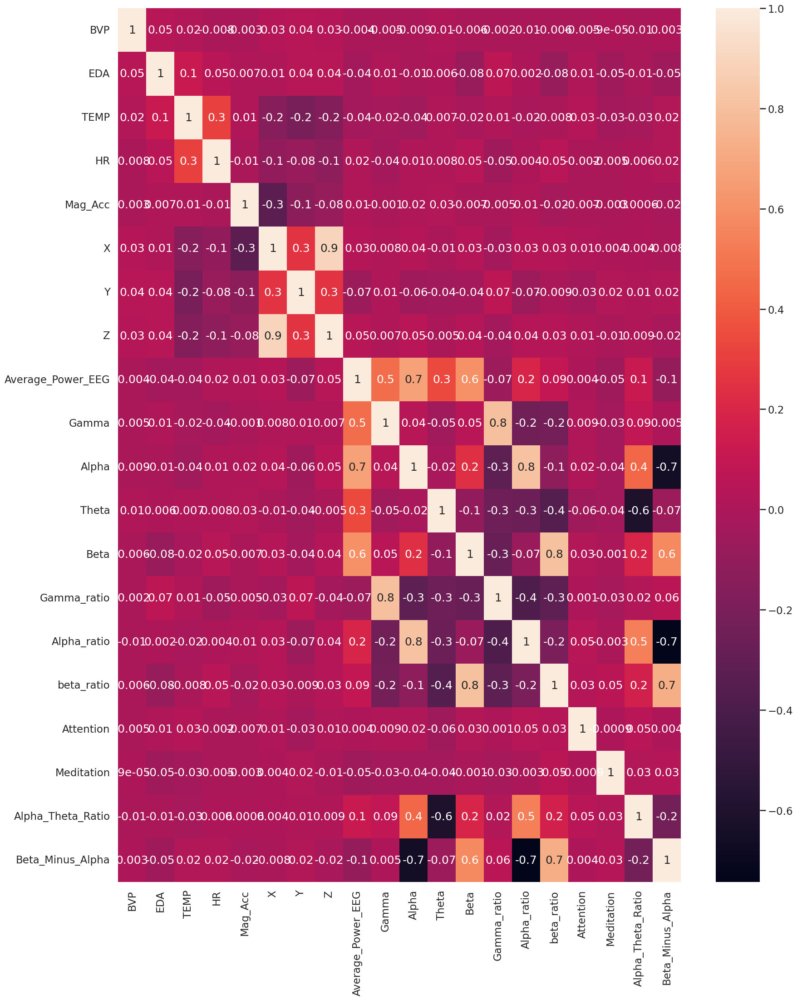

In [ ]:
corr_values = X_res.corr()
corr_values
plt.figure(figsize=(20,25))
sns.heatmap(data=corr_values, annot=True,fmt='.0g' )

In [ ]:
corr_values = X_res.corr()
corr_values
plt.figure(figsize=(20,25))
sns.heatmap(data=corr_values, annot=True,fmt='.0g' )
# Simplify by emptying all the data below the diagonal
tril_index = np.tril_indices_from(corr_values)

# Make the unused values NaNs
for coord in zip(*tril_index):
    corr_values.iloc[coord[0], coord[1]] = np.NaN

# Stack the data and convert to a data frame
corr_values = (corr_values
               .stack()
               .to_frame()
               .reset_index()
               .rename(columns={'level_0':'feature1',
                                'level_1':'feature2',
                                0:'correlation'}))

# Get the absolute values for sorting
corr_values['abs_correlation'] = corr_values.correlation.abs()

In [ ]:
corr_values

,feature1,feature2,correlation,abs_correlation
0,BVP,EDA,0.045343,0.045343
1,BVP,TEMP,0.022785,0.022785
2,BVP,HR,-0.007674,0.007674
3,BVP,Mag_Acc,-0.002786,0.002786
4,BVP,X,0.027661,0.027661
...,...,...,...,...
185,Attention,Alpha_Theta_Ratio,0.050735,0.050735
186,Attention,Beta_Minus_Alpha,0.003829,0.003829
187,Meditation,Alpha_Theta_Ratio,0.025855,0.025855
188,Meditation,Beta_Minus_Alpha,0.033898,0.033898


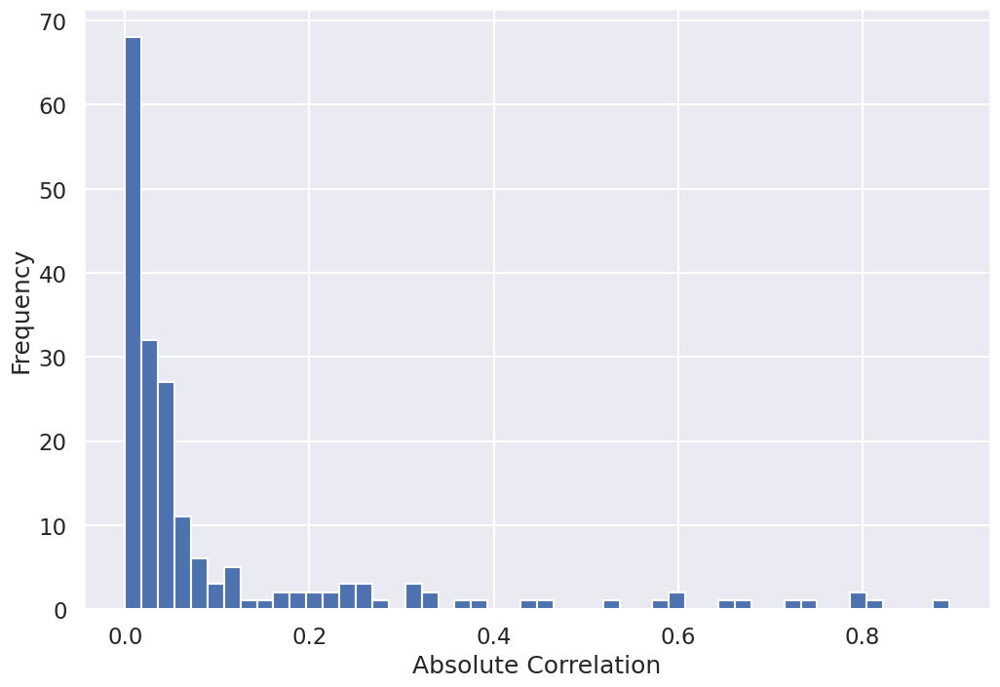

In [ ]:
sns.set_context('talk')

ax = corr_values.abs_correlation.hist(bins=50, figsize=(12, 8))
ax.set(xlabel='Absolute Correlation', ylabel='Frequency');

fname23 = "Abs Corr1.png"
plt.savefig(fname23, bbox_inches='tight', dpi=100)

In [ ]:
corr_values.sort_values('correlation', ascending=False).query('abs_correlation>0.8')

,feature1,feature2,correlation,abs_correlation


In [ ]:
# Splitting into Training, Validation, and Test Sets

# First, we split into train and remaining data (which will be split into validation and test)
X_train, X_remaining, y_train, y_remaining = train_test_split(X_res, y_res, test_size=0.3, random_state=42)

# Now, we split the remaining data into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_remaining, y_remaining, test_size=0.5, random_state=42)

# Print the shapes to verify the split
print("Training set shape:", X_train.shape)
print("Validation set shape:", X_val.shape)
print("Test set shape:", X_test.shape)

Training set shape: (53090, 20)
Validation set shape: (11377, 20)
Test set shape: (11377, 20)


In [ ]:
print(X_res[columns_to_check].var())
print(X_res[columns_to_check].std())

BVP                  0.000161
EDA                  0.036062
TEMP                 0.080304
HR                   0.010770
Mag_Acc              0.000025
X                    0.015629
Y                    0.004003
Z                    0.031735
Average_Power_EEG    0.000158
Gamma                0.000480
Alpha                0.000736
Theta                0.000436
Beta                 0.000622
Gamma_ratio          0.020293
Alpha_ratio          0.022340
beta_ratio           0.021447
Attention            0.080541
Meditation           0.083277
Alpha_Theta_Ratio    7.734420
Beta_Minus_Alpha     0.001036
dtype: float64
BVP                  0.012686
EDA                  0.189899
TEMP                 0.283380
HR                   0.103779
Mag_Acc              0.005021
X                    0.125017
Y                    0.063272
Z                    0.178143
Average_Power_EEG    0.012575
Gamma                0.021898
Alpha                0.027127
Theta                0.020886
Beta                 0.02

In [ ]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
X_val_scaled = scaler.transform(X_val)

In [ ]:
def get_accuracy(X_train, X_test, y_train, y_test, model):
    return  {"test Accuracy":metrics.accuracy_score(y_test, model.predict(X_test)),"train Accuracy": metrics.accuracy_score(y_train, model.predict(X_train))}

In [ ]:
from sklearn.feature_selection import RFE
# Initialize the base estimator and RFE
estimator = RandomForestClassifier(n_estimators=100, random_state=42)
selector = RFE(estimator, n_features_to_select=5, step=1)

# Fit RFE
selector = selector.fit(X_train_scaled, y_train)

# Get the selected features
selected_features = selector.support_
feature_ranking = selector.ranking_

print("Selected Features:", selected_features)
print("Feature Ranking:", feature_ranking)

Selected Features: [False  True  True  True False False  True  True False False False False
 False False False False False False False False]
Feature Ranking: [16  1  1  1 15  2  1  1  6 11  3 13  5  9  7  4 14 12 10  8]


In [ ]:
X_train_scaled

array([[-0.05078474, -0.67280427, -1.81180636, ...,  1.22440114,
         0.98609862, -0.80252191],
       [ 0.67553542,  1.59235163, -0.09411543, ...,  0.18723643,
        -0.71531324,  0.63085464],
       [ 1.02872315,  2.64878053,  1.1916118 , ..., -1.40308278,
         3.92846424, -1.76449307],
       ...,
       [-0.10729476, -0.69851404, -1.25279452, ...,  0.15266427,
        -0.15245541, -0.00737336],
       [ 0.26500665, -0.36030271, -1.7203317 , ...,  1.60469486,
         0.12766753, -2.37898751],
       [ 0.3810738 , -0.49849023, -0.82591275, ...,  0.98239604,
        -0.1214851 , -2.76885438]])

In [ ]:
# after rfe was applied

X_f = X_res[['BVP',	'EDA',	'TEMP',	'HR',	'X', 'Y', 'Z', 'Average_Power_EEG', 'Gamma_ratio', 'Alpha_Theta_Ratio', 'Beta_Minus_Alpha']]

In [ ]:
# Splitting into Training, Validation, and Test Sets

# First, we split into train and remaining data (which will be split into validation and test)
X_train, X_remaining, y_train, y_remaining = train_test_split(X_f, y_res, test_size=0.3, random_state=42)

# Now, we split the remaining data into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_remaining, y_remaining, test_size=0.5, random_state=42)

# Print the shapes to verify the split
print("Training set shape:", X_train.shape)
print("Validation set shape:", X_val.shape)
print("Test set shape:", X_test.shape)

Training set shape: (53090, 11)
Validation set shape: (11377, 11)
Test set shape: (11377, 11)


In [ ]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
X_val_scaled = scaler.transform(X_val)

Random Forest Model

In [ ]:
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from scipy.stats import randint

param_distributions_rf = {
    'n_estimators': randint(100, 1000),
    'max_depth': randint(10, 100),
    'min_samples_split': randint(2, 20),
    'min_samples_leaf': randint(1, 10),
    'max_features': ['auto', 'sqrt', 'log2']
}

# Initialize the classifier
rf = RandomForestClassifier(random_state=42)

# Set up RandomizedSearchCV
# n_iter=100 means we'll try 100 different random combinations
random_search = RandomizedSearchCV(
    estimator=rf,
    param_distributions=param_distributions_rf,
    n_iter=100,  # Number of parameter settings that are sampled
    cv=3,  # 3-fold cross-validation
    n_jobs=-1,  # Use all available cores
    verbose=2,  # Higher verbosity for logging
    random_state=42,
    scoring='accuracy'  # Or any other metric you're interested in
)

# Fit the random search to the data
random_search.fit(X_train_scaled, y_train)

# Output the results
print("Best parameters:", random_search.best_params_)
print("Best cross-validation score: {:.2f}".format(random_search.best_score_))
print("Test set score: {:.2f}".format(random_search.score(X_test_scaled, y_test)))

Fitting 3 folds for each of 100 candidates, totalling 300 fits


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:528: FitFailedWarning: 
105 fits failed out of a total of 300.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
56 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 866, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 1382, in wrapper
    estimator._validate_params()
  File "/usr/local/lib/python3.10/dist-packages/sklearn/base.py", line 436, in _validate_params
    validate_parameter_constraints(
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils

Best parameters: {'max_depth': 21, 'max_features': 'log2', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 267}
Best cross-validation score: 1.00
Test set score: 1.00


In [ ]:
RF = RandomForestClassifier(max_depth = 21, min_samples_split = 2, n_estimators = 267,
                            max_features = 'log2', min_samples_leaf = 1, random_state=42)
RF.fit(X_train_scaled, y_train)

RandomForestClassifier(max_depth=21, max_features='log2', n_estimators=267,
                       random_state=42)

In [ ]:
get_accuracy(X_train_scaled, X_test_scaled, y_train, y_test, RF)

{'test Accuracy': 0.9997363100993232, 'train Accuracy': 1.0}

In [ ]:
y_predRF = list()
y_probRF = list()

coeff_labels = ['Random Forest']
coeff_models = [RF]

for lab,mod in zip(coeff_labels, coeff_models):
    y_predRF.append(pd.Series(mod.predict(X_test_scaled), name=lab))
    y_probRF.append(pd.Series(mod.predict_proba(X_test_scaled).max(axis=1), name=lab))

y_predRF = pd.concat(y_predRF, axis=1)
y_probRF = pd.concat(y_probRF, axis=1)

y_predRF.head()

,Random Forest
0,0
1,0
2,0
3,1
4,0


In [ ]:
from sklearn.metrics import precision_recall_fscore_support as score
RFmetrics = list()
RFcm = dict()

for lab in coeff_labels:

    # Preciision, recall, f-score from the multi-class support function
    precision, recall, fscore, _ = score(y_test, y_predRF[lab], average='weighted')

    # The usual way to calculate accuracy
    accuracy = accuracy_score(y_test, y_predRF[lab])

    # ROC-AUC scores can be calculated by binarizing the data
    auc = roc_auc_score(label_binarize(y_test, classes=[0,1]),
              label_binarize(y_predRF[lab], classes=[0,1]),
              average='weighted')


    RFmetrics.append(pd.Series({'precision':precision, 'recall':recall,
                              'fscore':fscore, 'accuracy':accuracy,
                              'auc':auc},
                             name=lab))

RFmetrics = pd.concat(RFmetrics, axis=1)

In [ ]:
RFmetrics

,Random Forest
precision,0.999736
recall,0.999736
fscore,0.999736
accuracy,0.999736
auc,0.999736


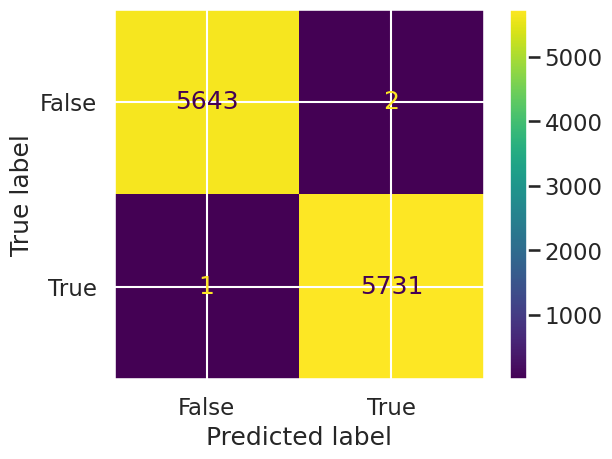

In [ ]:
from sklearn.multiclass import OneVsRestClassifier
from sklearn.preprocessing import label_binarize
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

from sklearn import metrics
confusion_matrix = metrics.confusion_matrix(y_test, y_predRF)

cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = [False, True])
cm_display.plot()

plt.show()

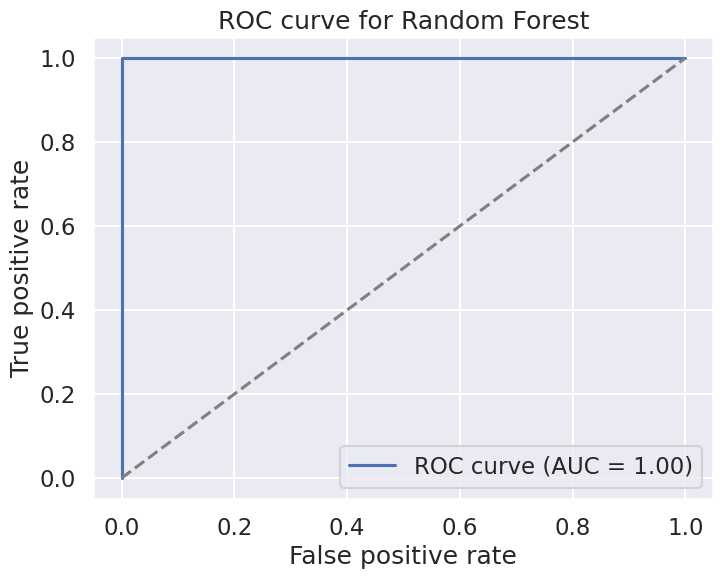

In [ ]:
# Predict the probabilities of the positive class on the test set.
from sklearn.metrics import roc_auc_score, roc_curve, auc

y_proba = RF.predict_proba(X_test_scaled)[:, 1]

# Compute the ROC curve and the AUC score.
fpr, tpr, thresholds = roc_curve(y_test, y_proba)
auc_score = roc_auc_score(y_test, y_proba)
auc_value = auc(fpr, tpr)

# Plot the ROC curve and show the AUC score.
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC curve (AUC = {auc_score:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve for Random Forest')
plt.legend()
plt.show()

In [ ]:
# Validate the model
val_score = RF.score(X_val_scaled, y_val)
print("Validation score: {:.2f}".format(val_score))

Validation score: 1.00


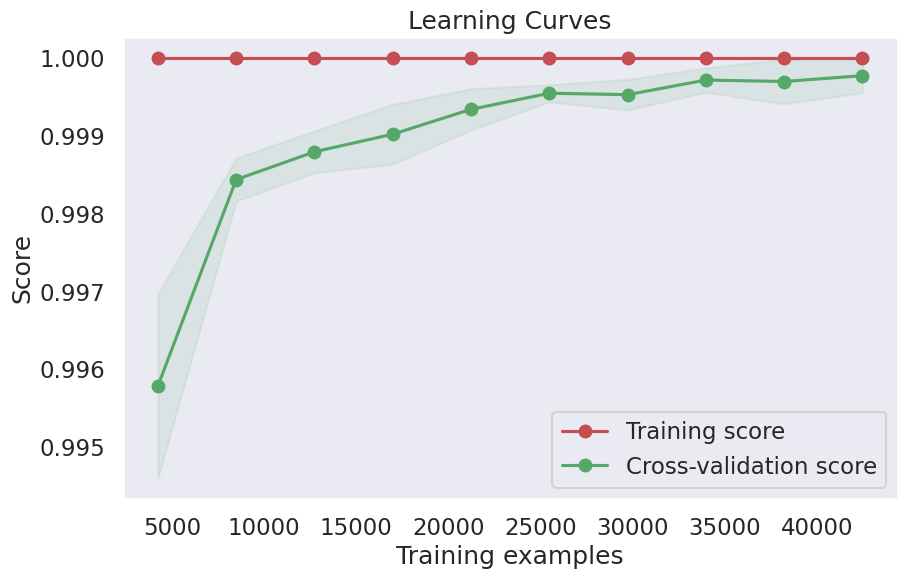

In [ ]:
from sklearn.model_selection import learning_curve

train_sizes, train_scores, val_scores = learning_curve(
    RF, X_train_scaled, y_train, train_sizes=np.linspace(0.1, 1.0, 10), cv=5, scoring='accuracy', n_jobs=-1)

# Plotting learning curves
import matplotlib.pyplot as plt

train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
val_scores_mean = np.mean(val_scores, axis=1)
val_scores_std = np.std(val_scores, axis=1)

plt.figure(figsize=(10, 6))
plt.title("Learning Curves")
plt.xlabel("Training examples")
plt.ylabel("Score")
plt.grid()

plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color="r")
plt.fill_between(train_sizes, val_scores_mean - val_scores_std, val_scores_mean + val_scores_std, alpha=0.1, color="g")
plt.plot(train_sizes, train_scores_mean, 'o-', color="r", label="Training score")
plt.plot(train_sizes, val_scores_mean, 'o-', color="g", label="Cross-validation score")
plt.legend(loc="best")
plt.show()

In [ ]:
# Feature importance
importances = RF.feature_importances_
for feature, importance in zip(range(X_f.shape[1]), importances):
    print(f"Feature {feature}: {importance:.4f}")

Feature 0: 0.0013
Feature 1: 0.2673
Feature 2: 0.2539
Feature 3: 0.1665
Feature 4: 0.0682
Feature 5: 0.0872
Feature 6: 0.0928
Feature 7: 0.0159
Feature 8: 0.0153
Feature 9: 0.0146
Feature 10: 0.0170


SVM Model

In [ ]:
!nvidia-smi

Fri Jan 10 22:20:09 2025       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   37C    P0              52W / 400W |      2MiB / 40960MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [ ]:
!pip install cudf-cu12 cuml-cu12

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
INFO: pip is looking at multiple versions of cuml-cu12 to determine which version is compatible with other requirements. This could take a while.
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Installing build dependencies ... done
  G

In [ ]:
import cudf
from cuml.svm import SVC as cumlSVC
import cuml.model_selection as cms
from cuml.datasets import make_classification

In [ ]:
from sklearn.svm import SVC
from scipy.stats import uniform, randint
from sklearn.model_selection import learning_curve
from sklearn.model_selection import RandomizedSearchCV

In [ ]:
X_train_scaled_df = pd.DataFrame(X_train_scaled)
X_test_scaled_df = pd.DataFrame(X_test_scaled)
X_val_scaled_df = pd.DataFrame(X_val_scaled)

In [ ]:
# Define your parameter distributions
param_distributions_svm = {
    'C': uniform(0.1, 100),
    'kernel': ['rbf', 'linear'],
    'gamma': uniform(0.0001, 0.1),
    'degree': randint(1, 6)
}

# Create an instance of cumlSVC
svm = cumlSVC(random_state=42)

# Use sklearn's RandomizedSearchCV
random_search_svm = RandomizedSearchCV(
    estimator=svm,
    param_distributions=param_distributions_svm,
    n_iter=100,
    cv=3,
    n_jobs=-1,
    verbose=2,
    random_state=42,
    scoring='accuracy'
)

# Fit the random search (this will run on CPU)
random_search_svm.fit(X_train_scaled_df.values, y_train.values)

# Print the best parameters
print("Best parameters:", random_search_svm.best_params_)

# Now, use the best parameters to train on GPU
best_svm = cumlSVC(**random_search_svm.best_params_, random_state=42)
best_svm.fit(X_train_scaled_df, y_train)

# Evaluate on the test set
test_score = best_svm.score(X_test_scaled_df, y_test)
print("Test set score with best params: {:.2f}".format(test_score))

Fitting 3 folds for each of 100 candidates, totalling 300 fits


/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Best parameters: {'C': 84.32847745949985, 'degree': 4, 'gamma': 0.09404989415641891, 'kernel': 'linear'}
[W] [11:34:33.032634] SVC with the linear kernel can be much faster using the specialized solver provided by LinearSVC. Consider switching to LinearSVC if tranining takes too long.
Test set score with best params: 0.71


In [ ]:
SVM = cumlSVC(C = 84.32847745949985, degree = 4, gamma = 0.09404989415641891,
              kernel = 'linear', probability=True, random_state=42)
SVM.fit(X_train_scaled_df, y_train)

[W] [18:14:09.355058] SVC with the linear kernel can be much faster using the specialized solver provided by LinearSVC. Consider switching to LinearSVC if tranining takes too long.
[W] [18:14:09.355139] Random state is currently ignored by probabilistic SVC


SVC()

In [ ]:
get_accuracy(X_train_scaled, X_test_scaled, y_train, y_test, SVM)

{'test Accuracy': 0.7136327678649907, 'train Accuracy': 0.7143906573742701}

In [ ]:
y_predSVM = list()
y_probSVM = list()

coeff_labels = ['SVM']
coeff_models = [SVM]

for lab,mod in zip(coeff_labels, coeff_models):
    y_predSVM.append(pd.Series(mod.predict(X_test_scaled), name=lab))
    y_probSVM.append(pd.Series(mod.predict_proba(X_test_scaled).max(axis=1), name=lab))

y_predSVM = pd.concat(y_predSVM, axis=1)
y_probSVM = pd.concat(y_probSVM, axis=1)

y_predSVM.head()

,SVM
0,0
1,0
2,0
3,1
4,0


In [ ]:
from sklearn.metrics import precision_recall_fscore_support as score
SVMmetrics = list()
SVMcm = dict()

for lab in coeff_labels:

    # Preciision, recall, f-score from the multi-class support function
    precision, recall, fscore, _ = score(y_test, y_predSVM[lab], average='weighted')

    # The usual way to calculate accuracy
    accuracy = accuracy_score(y_test, y_predSVM[lab])

    # ROC-AUC scores can be calculated by binarizing the data
    auc = roc_auc_score(label_binarize(y_test, classes=[0,1]),
              label_binarize(y_predSVM[lab], classes=[0,1]),
              average='weighted')


    SVMmetrics.append(pd.Series({'precision':precision, 'recall':recall,
                              'fscore':fscore, 'accuracy':accuracy,
                              'auc':auc},
                             name=lab))

SVMmetrics = pd.concat(SVMmetrics, axis=1)

In [ ]:
SVMmetrics

,SVM
precision,0.715404
recall,0.713633
fscore,0.713199
accuracy,0.713633
auc,0.713944


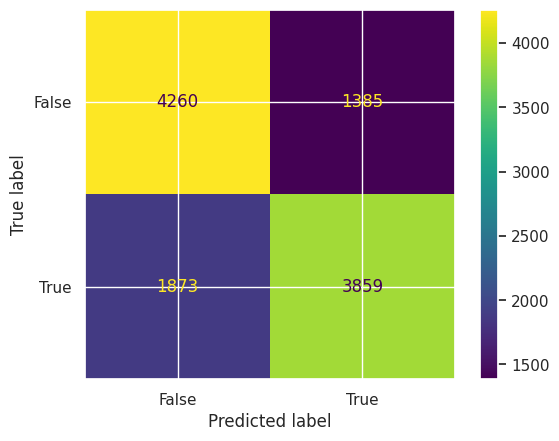

In [ ]:
from sklearn.metrics import roc_curve, auc as roc_auc
import matplotlib.pyplot as plt

from sklearn.multiclass import OneVsRestClassifier
from sklearn.preprocessing import label_binarize
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

from sklearn import metrics
confusion_matrix = metrics.confusion_matrix(y_test, y_predSVM)

cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = [False, True])
cm_display.plot()

fname200 = "cLSVM.png"
plt.savefig(fname200, bbox_inches='tight', dpi=100)
plt.show()

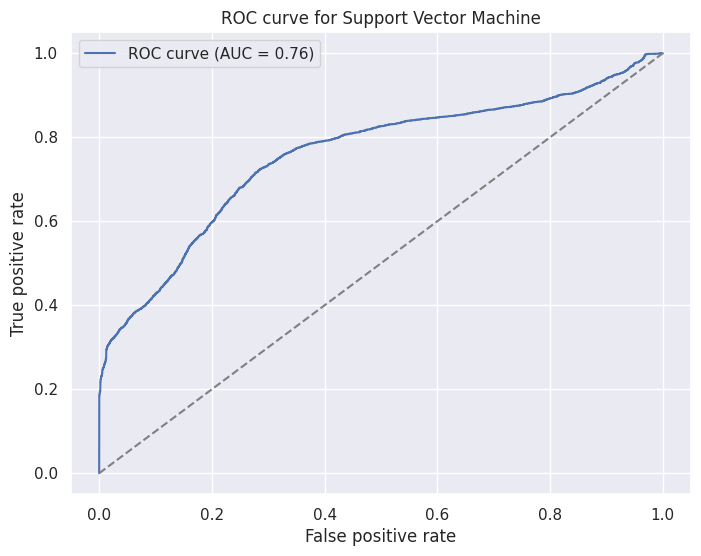

In [ ]:
# Predict the probabilities of the positive class on the test set.
from sklearn.metrics import roc_auc_score, roc_curve, auc

y_proba_svm = SVM.predict_proba(X_test_scaled)[:, 1]

# Compute the ROC curve and the AUC score.
fpr, tpr, thresholds = roc_curve(y_test, y_proba_svm)
auc_score = roc_auc_score(y_test, y_proba_svm)
auc_value = auc(fpr, tpr)

# Plot the ROC curve and show the AUC score.
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC curve (AUC = {auc_score:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve for Support Vector Machine')
plt.legend()
plt.show()

In [ ]:
import cudf
import cupy as cp

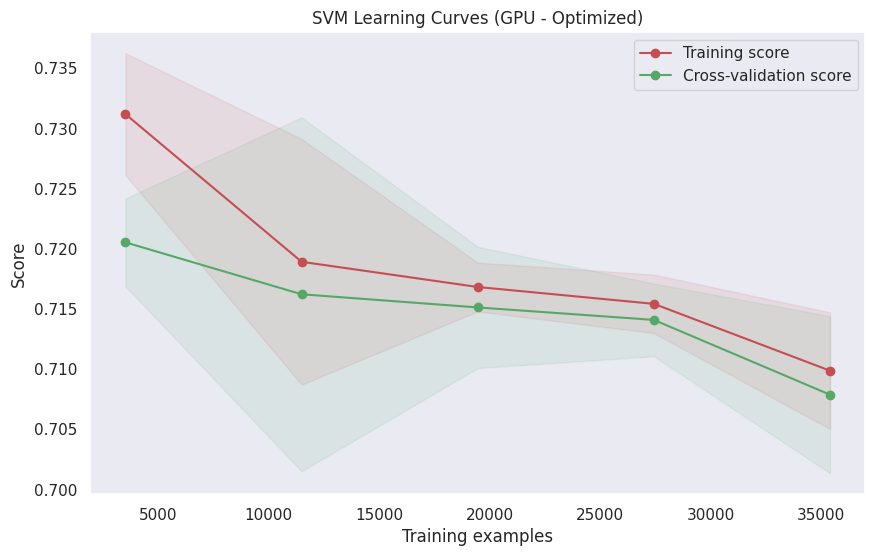

In [ ]:
# Use a simpler model and fewer training sizes
SVM1 = cumlSVC(C=0.1, kernel='linear', probability=False, random_state=42)
train_sizes = np.linspace(0.1, 1.0, 5)

# Reduce CV folds and use less data if necessary
train_sizes, train_scores, val_scores = learning_curve(
    SVM1,  X_train_scaled, y_train, train_sizes=train_sizes, cv=3, scoring='accuracy', n_jobs=4)

# Convert scores to numpy arrays for CPU plotting
train_scores = cp.asnumpy(train_scores)
val_scores = cp.asnumpy(val_scores)

# Calculate mean and std for training and validation scores
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
val_scores_mean = np.mean(val_scores, axis=1)
val_scores_std = np.std(val_scores, axis=1)

# Plotting
plt.figure(figsize=(10, 6))
plt.title("SVM Learning Curves (GPU - Optimized)")
plt.xlabel("Training examples")
plt.ylabel("Score")
plt.grid()

plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color="r")
plt.fill_between(train_sizes, val_scores_mean - val_scores_std, val_scores_mean + val_scores_std, alpha=0.1, color="g")
plt.plot(train_sizes, train_scores_mean, 'o-', color="r", label="Training score")
plt.plot(train_sizes, val_scores_mean, 'o-', color="g", label="Cross-validation score")
plt.legend(loc="best")
plt.show()

In [ ]:
# Validate the model
val_score = SVM.score(X_val_scaled_df, y_val)
print("Validation score: {:.2f}".format(val_score))

Validation score: 0.71


XGBoost

In [ ]:
from xgboost import XGBClassifier
import cudf
import cupy as cp

In [ ]:
X_train_cudf = cudf.DataFrame.from_pandas(pd.DataFrame(X_train_scaled_df))
y_train_cudf = cudf.Series.from_pandas(pd.Series(y_train))
X_test_cudf = cudf.DataFrame.from_pandas(pd.DataFrame(X_test_scaled_df))
y_test_cudf = cudf.Series.from_pandas(pd.Series(y_test))

In [ ]:
from sklearn.base import BaseEstimator, ClassifierMixin
from xgboost import XGBClassifier as XGBOriginal
import cupy as cp

class TagContainer:
    def __init__(self, **kwargs):
        for key, value in kwargs.items():
            setattr(self, key, value)
        # Ensure 'input_tags' is defined
        self.input_tags = TagContainerInputTags()

class TagContainerInputTags:
    def __init__(self):
        self.pairwise = False

class CustomXGBClassifier(BaseEstimator, ClassifierMixin):
    def __init__(self, **kwargs):
        self.xgb = None
        self.kwargs = kwargs

    def fit(self, X, y, **kwargs):
        X_cupy = X.to_cupy() if hasattr(X, 'to_cupy') else X
        y_cupy = y.to_cupy() if hasattr(y, 'to_cupy') else y

        self.xgb = XGBOriginal(tree_method='gpu_hist', gpu_id=0, random_state=42, **self.kwargs)
        self.xgb.fit(X_cupy, y_cupy, **kwargs)
        return self

    def predict(self, X):
        X_cupy = X.to_cupy() if hasattr(X, 'to_cupy') else X
        return self.xgb.predict(X_cupy)

    def predict_proba(self, X):
        X_cupy = X.to_cupy() if hasattr(X, 'to_cupy') else X
        return self.xgb.predict_proba(X_cupy)

    def score(self, X, y):
        X_cupy = X.to_cupy() if hasattr(X, 'to_cupy') else X
        y_cupy = y.to_cupy() if hasattr(y, 'to_cupy') else y
        return self.xgb.score(X_cupy, y_cupy)

    def __sklearn_tags__(self):
        tags = TagContainer(
            binary_only=False,
            multiclass=True,
            multilabel=False,
            multioutput=False,
            requires_y=True,
            poor_score=False,
            allow_nan=False,
            requires_fit=True,
            X_types=['2darray'],
            estimator_type='classifier'
        )
        return tags

    def set_params(self, **params):
        self.kwargs.update(params)
        return self

    def get_params(self, deep=True):
        return self.kwargs

# Initialize with GPU support
custom_xgb_model = CustomXGBClassifier()

# Define the parameter distributions for XGBoost
from scipy.stats import uniform, randint
param_distributions = {
    'max_depth': randint(3, 7),
    'learning_rate': uniform(0.01, 0.2),
    'n_estimators': randint(100, 500),
    'gamma': uniform(0, 0.2),
    'subsample': uniform(0.6, 0.4),
    'colsample_bytree': uniform(0.6, 0.4),
    'reg_alpha': uniform(0, 5),
    'reg_lambda': uniform(1, 5)
}

# Set up RandomizedSearchCV
from sklearn.model_selection import RandomizedSearchCV

random_search_xg = RandomizedSearchCV(
    estimator=custom_xgb_model,
    param_distributions=param_distributions,
    n_iter=50,
    cv=2,
    n_jobs=4,
    verbose=2,
    random_state=42,
    scoring='accuracy'
)

# Convert cuDF to numpy for compatibility with RandomizedSearchCV if necessary
if isinstance(X_train_cudf, cudf.DataFrame):
    X_train_np = X_train_cudf.to_numpy()
else:
    X_train_np = X_train_cudf

if isinstance(y_train_cudf, cudf.Series):
    y_train_np = y_train_cudf.to_numpy()
else:
    y_train_np = y_train_cudf

# Fit the random search to the data
random_search_xg.fit(X_train_np, y_train_np)

# Best parameters
print("Best parameters:", random_search_xg.best_params_)

# Best cross-validation score
print("Best cross-validation score: {:.2f}".format(random_search_xg.best_score_))

Fitting 2 folds for each of 50 candidates, totalling 100 fits


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_search.py:1107: UserWarning: One or more of the test scores are non-finite: [nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [18:47:40] WARNING: /workspace/src/common/error_msg.cc:45: `gpu_id` is deprecated since2.0.0, use `device` instead. E.g. device=cpu/cuda/cuda:0
  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [18:47:40] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


Best parameters: {'colsample_bytree': 0.749816047538945, 'gamma': 0.19014286128198324, 'learning_rate': 0.15639878836228102, 'max_depth': 3, 'n_estimators': 120, 'reg_alpha': 0.7800932022121826, 'reg_lambda': 1.7799726016810133, 'subsample': 0.6232334448672797}
Best cross-validation score: nan


In [ ]:
from sklearn.base import BaseEstimator, ClassifierMixin
from xgboost import XGBClassifier as XGBOriginal
import cupy as cp
import cudf
import pandas as pd

class TagContainer:
    def __init__(self, **kwargs):
        for key, value in kwargs.items():
            setattr(self, key, value)
        self.input_tags = TagContainerInputTags()

class TagContainerInputTags:
    def __init__(self):
        self.pairwise = False

class CustomXGBClassifier(BaseEstimator, ClassifierMixin):
    def __init__(self, **kwargs):
        # Store all parameters except tree_method, gpu_id, and random_state, which we'll set explicitly
        self.kwargs = {k: v for k, v in kwargs.items() if k not in ['tree_method', 'gpu_id', 'random_state']}
        self.tree_method = kwargs.get('tree_method', 'gpu_hist')
        self.gpu_id = kwargs.get('gpu_id', 0)
        self.random_state = kwargs.get('random_state', 42)

    def fit(self, X, y, **kwargs):
        X_cupy = X.to_cupy() if hasattr(X, 'to_cupy') else X
        y_cupy = y.to_cupy() if hasattr(y, 'to_cupy') else y

        # Initialize XGBClassifier with the parameters
        self.xgb = XGBOriginal(tree_method=self.tree_method, gpu_id=self.gpu_id, random_state=self.random_state, **self.kwargs)
        self.xgb.fit(X_cupy, y_cupy, **kwargs)
        return self

    def predict(self, X):
        X_cupy = X.to_cupy() if hasattr(X, 'to_cupy') else X
        return self.xgb.predict(X_cupy)

    def predict_proba(self, X):
        X_cupy = X.to_cupy() if hasattr(X, 'to_cupy') else X
        return self.xgb.predict_proba(X_cupy)

    def score(self, X, y):
        X_cupy = X.to_cupy() if hasattr(X, 'to_cupy') else X
        y_cupy = y.to_cupy() if hasattr(y, 'to_cupy') else y
        return self.xgb.score(X_cupy, y_cupy)

    def __sklearn_tags__(self):
        tags = TagContainer(
            binary_only=False,
            multiclass=True,
            multilabel=False,
            multioutput=False,
            requires_y=True,
            poor_score=False,
            allow_nan=False,
            requires_fit=True,
            X_types=['2darray'],
            estimator_type='classifier'
        )
        return tags

    def set_params(self, **params):
        # Remove tree_method, gpu_id, and random_state from params if they're passed here
        params = {k: v for k, v in params.items() if k not in ['tree_method', 'gpu_id', 'random_state']}
        self.kwargs.update(params)
        if 'random_state' in params:
            self.random_state = params['random_state']
        return self

    def get_params(self, deep=True):
        # Combine kwargs with explicitly set parameters
        return {**self.kwargs, 'tree_method': self.tree_method, 'gpu_id': self.gpu_id, 'random_state': self.random_state}

# Initialize the XGBoost classifier with GPU support and your specified parameters
xgb_model = CustomXGBClassifier(
    tree_method='gpu_hist',
    gpu_id=0,
    colsample_bytree=0.749816047538945,
    gamma=0.19014286128198324,
    learning_rate=0.15639878836228102,
    max_depth=3,
    n_estimators=120,
    reg_alpha=0.7800932022121826,
    reg_lambda=1.7799726016810133,
    subsample=0.6232334448672797,
    random_state=42
)

# Assuming X_train_scaled and y_train are your data
# If they are not already cuDF objects, convert them
if not isinstance(X_train, cudf.DataFrame):
    X_train_scaled = cudf.DataFrame.from_pandas(pd.DataFrame(X_train))
if not isinstance(y_train, cudf.Series):
    y_train = cudf.Series.from_pandas(pd.Series(y_train))

# Train the model
xgb_model.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [21:37:11] WARNING: /workspace/src/common/error_msg.cc:45: `gpu_id` is deprecated since2.0.0, use `device` instead. E.g. device=cpu/cuda/cuda:0
  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [21:37:11] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)


CustomXGBClassifier(colsample_bytree=0.749816047538945,
                    gamma=0.19014286128198324, gpu_id=0,
                    learning_rate=0.15639878836228102, max_depth=3,
                    n_estimators=120, random_state=42,
                    reg_alpha=0.7800932022121826, reg_lambda=1.7799726016810133,
                    subsample=0.6232334448672797, tree_method='gpu_hist')

In [ ]:
from xgboost import XGBClassifier
import numpy as np
from sklearn import set_config

# Disable HTML representation for unfitted estimators
set_config(display='text')
# Initialize the XGBoost classifier with the specified parameters for CPU
xgb_model = XGBClassifier(
    colsample_bytree=0.749816047538945,
    gamma=0.19014286128198324,
    learning_rate=0.15639878836228102,
    max_depth=3,
    n_estimators=120,
    reg_alpha=0.7800932022121826,
    reg_lambda=1.7799726016810133,
    subsample=0.6232334448672797,
    random_state=42
)

# Train the model
xgb_model.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.749816047538945, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0.19014286128198324,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.15639878836228102,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=3, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=120, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

In [ ]:
y_predxgb = list()
y_probxgb = list()

coeff_labels = ['xgb']
coeff_models = [xgb_model]

for lab,mod in zip(coeff_labels, coeff_models):
    y_predxgb.append(pd.Series(mod.predict(X_test), name=lab))
    y_probxgb.append(pd.Series(mod.predict_proba(X_test).max(axis=1), name=lab))

y_predxgb = pd.concat(y_predxgb, axis=1)
y_probxgb = pd.concat(y_probxgb, axis=1)

y_predxgb.head()

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [21:37:22] WARNING: /workspace/src/common/error_msg.cc:27: The tree method `gpu_hist` is deprecated since 2.0.0. To use GPU training, set the `device` parameter to CUDA instead.

    E.g. tree_method = "hist", device = "cuda"

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [21:37:22] WARNING: /workspace/src/common/error_msg.cc:58: Falling back to prediction using DMatrix due to mismatched devices. This might lead to higher memory usage and slower performance. XGBoost is running on: cuda:0, while the input data is on: cpu.
Potential solutions:
- Use a data structure that matches the device ordinal in the booster.
- Set the device for booster before call to inplace_predict.

This warning will only be shown once.

  warnings.warn(smsg, UserWarning)


,xgb
0,1
1,0
2,1
3,0
4,1


In [ ]:
from sklearn.metrics import precision_recall_fscore_support as score
from sklearn.metrics import roc_auc_score as roc_asc
xgbmetrics = list()
xgbcm = dict()

for lab in coeff_labels:

    # Preciision, recall, f-score from the multi-class support function
    precision, recall, fscore, _ = score(y_test, y_predxgb[lab], average='weighted')

    # The usual way to calculate accuracy
    accuracy = accuracy_score(y_test, y_predxgb[lab])

    # ROC-AUC scores can be calculated by binarizing the data
    auc = roc_asc(label_binarize(y_test, classes=[0,1]),
              label_binarize(y_predxgb[lab], classes=[0,1]),
              average='weighted')


    xgbmetrics.append(pd.Series({'precision':precision, 'recall':recall,
                              'fscore':fscore, 'accuracy':accuracy,
                              'auc':auc},
                             name=lab))

xgbmetrics = pd.concat(xgbmetrics, axis=1)

In [ ]:
xgbmetrics

,xgb
precision,0.976476
recall,0.976465
fscore,0.976466
accuracy,0.976465
auc,0.976502


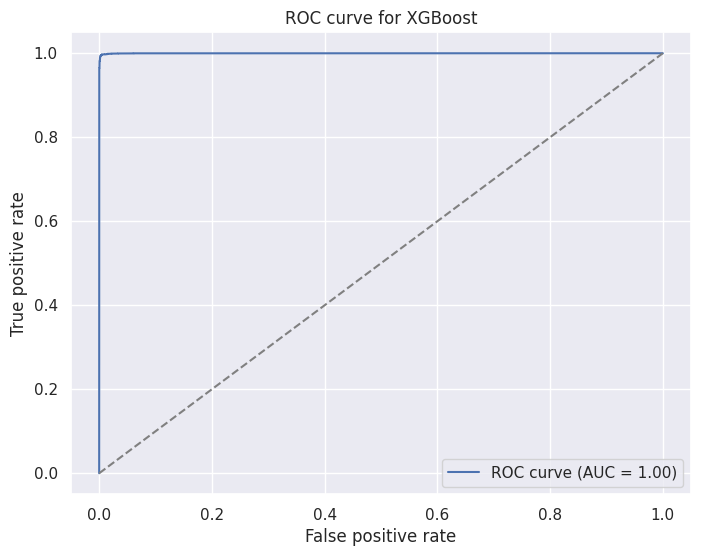

In [ ]:
# Predict the probabilities of the positive class on the test set.
from sklearn.metrics import roc_auc_score, roc_curve, auc

y_proba_xgb = xgb_model.predict_proba(X_test_scaled)[:, 1]

# Compute the ROC curve and the AUC score.
fpr, tpr, thresholds = roc_curve(y_test, y_proba_xgb)
auc_score = roc_auc_score(y_test, y_proba_xgb)
auc_value = auc(fpr, tpr)

# Plot the ROC curve and show the AUC score.
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC curve (AUC = {auc_score:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve for XGBoost')
plt.legend()
plt.show()

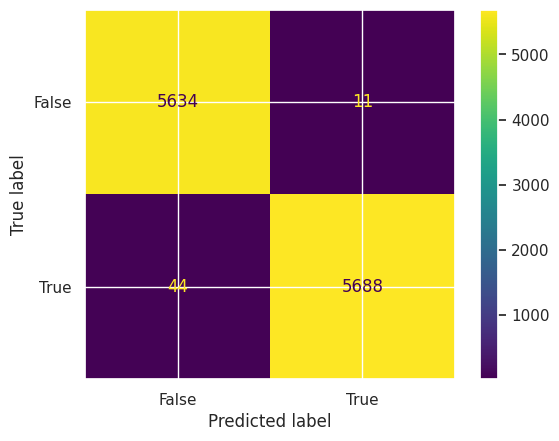

In [ ]:
from sklearn.metrics import roc_curve, auc as roc_auc
import matplotlib.pyplot as plt

from sklearn.multiclass import OneVsRestClassifier
from sklearn.preprocessing import label_binarize
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

from sklearn import metrics
confusion_matrix = metrics.confusion_matrix(y_test, y_predxgb)

cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = [False, True])
cm_display.plot()
plt.show()

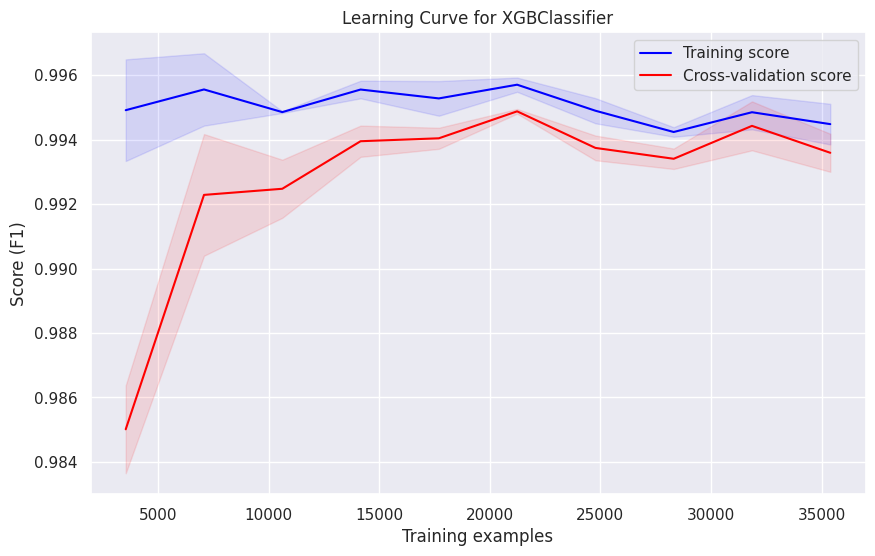

Training mean scores: [0.99491041 0.99555336 0.99485063 0.99555081 0.99527554 0.99570085
 0.99489367 0.99423393 0.99484715 0.99447797]
Training std scores: [1.57626444e-03 1.12277777e-03 2.73200676e-05 2.73322541e-04
 5.37258700e-04 2.20301260e-04 3.90423045e-04 1.48338844e-04
 5.31138320e-04 6.30383668e-04]
Validation mean scores: [0.98501423 0.99228326 0.99247317 0.99394784 0.99403881 0.99487488
 0.99374035 0.9934037  0.99442427 0.9935893 ]
Validation std scores: [1.36348485e-03 1.88671528e-03 9.01162763e-04 4.84311166e-04
 3.26980726e-04 7.23780583e-05 3.83172666e-04 3.16569492e-04
 7.58342252e-04 5.89779199e-04]


In [ ]:
from xgboost import XGBClassifier
import numpy as np
from sklearn.model_selection import learning_curve
from sklearn import set_config
from sklearn.base import BaseEstimator, ClassifierMixin
import matplotlib.pyplot as plt

# Disable HTML representation for unfitted estimators
set_config(display='text')

class TagContainerInputTags:
    def __init__(self):
        self.pairwise = False

class TagContainer:
    def __init__(self, **kwargs):
        for key, value in kwargs.items():
            setattr(self, key, value)
        self.input_tags = TagContainerInputTags()

class CustomXGBClassifier(BaseEstimator, ClassifierMixin):
    def __init__(self, **kwargs):
        self.kwargs = kwargs
        self.xgb = None

    def fit(self, X, y):
        self.xgb = XGBClassifier(**self.kwargs)
        self.xgb.fit(X, y)
        # After fitting, we set the classes_ attribute
        self.classes_ = self.xgb.classes_
        return self

    def predict(self, X):
        return self.xgb.predict(X)

    def predict_proba(self, X):
        return self.xgb.predict_proba(X)

    def score(self, X, y):
        return self.xgb.score(X, y)

    def __sklearn_tags__(self):
        return TagContainer(
            X_types=['2darray'],
            requires_y=True,
            poor_score=False,
            allow_nan=False,
            requires_fit=True,
            estimator_type='classifier'
        )

    def get_params(self, deep=True):
        return self.kwargs

    def set_params(self, **params):
        self.kwargs.update(params)
        return self

# Initialize the XGBoost classifier with the specified parameters for CPU
xgb_model = CustomXGBClassifier(
    colsample_bytree=0.749816047538945,
    gamma=0.19014286128198324,
    learning_rate=0.15639878836228102,
    max_depth=3,
    n_estimators=120,
    reg_alpha=0.7800932022121826,
    reg_lambda=1.7799726016810133,
    subsample=0.6232334448672797,
    random_state=42
)

# Define the train sizes for the learning curve
train_sizes = np.linspace(0.1, 1.0, 10)

# Convert cuDF DataFrames to NumPy arrays
X_train_np = X_train_scaled.to_numpy()
y_train_np = y_train.to_numpy()

# Compute the learning curve
train_sizes, train_scores, val_scores = learning_curve(
    xgb_model, X_train_np, y_train_np, train_sizes=train_sizes, cv=3, scoring='f1', n_jobs=1)

# Calculate mean and standard deviation for training set scores
train_mean = np.nanmean(train_scores, axis=1)
train_std = np.nanstd(train_scores, axis=1)

# Calculate mean and standard deviation for validation set scores
val_mean = np.nanmean(val_scores, axis=1)
val_std = np.nanstd(val_scores, axis=1)

# Plot the learning curve
plt.figure(figsize=(10, 6))
plt.title('Learning Curve for XGBClassifier')
plt.xlabel('Training examples')
plt.ylabel('Score (F1)')
plt.plot(train_sizes, train_mean, label='Training score', color='blue')
plt.plot(train_sizes, val_mean, label='Cross-validation score', color='red')

# Plotting the standard deviation as a shaded area around the mean
plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, alpha=0.1, color='blue')
plt.fill_between(train_sizes, val_mean - val_std, val_mean + val_std, alpha=0.1, color='red')

plt.legend(loc='best')
plt.grid(True)
plt.show()

print("Training mean scores:", train_mean)
print("Training std scores:", train_std)
print("Validation mean scores:", val_mean)
print("Validation std scores:", val_std)

Neural Network

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.model_selection import RandomizedSearchCV
from sklearn.base import BaseEstimator, ClassifierMixin
from scipy.stats import uniform, randint
import numpy as np

# Ensure TensorFlow is using GPU
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

class TagContainerInputTags:
    def __init__(self):
        self.pairwise = False

class TagContainer:
    def __init__(self, **kwargs):
        for key, value in kwargs.items():
            setattr(self, key, value)
        self.input_tags = TagContainerInputTags()

class KerasClassifier(BaseEstimator, ClassifierMixin):
    def __init__(self, neurons=50, learning_rate=0.001, epochs=50, batch_size=32, verbose=0):
        self.neurons = neurons
        self.learning_rate = learning_rate
        self.epochs = epochs
        self.batch_size = batch_size
        self.verbose = verbose
        self.model = None
        self.classes_ = None

    def fit(self, X, y, **kwargs):
        self.model = self._create_model()
        self.model.fit(X, y, epochs=self.epochs, batch_size=self.batch_size, verbose=self.verbose)
        self.classes_ = np.unique(y)
        return self

    def predict(self, X):
        return (self.model.predict(X) > 0.5).astype(int)

    def predict_proba(self, X):
        return self.model.predict(X)

    def score(self, X, y):
        return self.model.evaluate(X, y, verbose=self.verbose)[1]

    def _create_model(self):
        model = Sequential([
            Dense(self.neurons, input_shape=(X_train_np.shape[1],), activation='relu'),
            Dense(1, activation='sigmoid')
        ])
        model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=self.learning_rate),
                      loss='binary_crossentropy',
                      metrics=['accuracy'])
        return model

    def __sklearn_tags__(self):
        return TagContainer(
            X_types=['2darray'],
            requires_y=True,
            poor_score=False,
            allow_nan=False,
            requires_fit=True,
            estimator_type='classifier'
        )

    def get_params(self, deep=True):
        return {
            'neurons': self.neurons,
            'learning_rate': self.learning_rate,
            'epochs': self.epochs,
            'batch_size': self.batch_size,
            'verbose': self.verbose
        }

    def set_params(self, **params):
        for key, value in params.items():
            if key not in self.get_params():
                raise ValueError(f"Invalid parameter {key!r} for estimator {self}. "
                                 f"Valid parameters are: {list(self.get_params().keys())!r}.")
            setattr(self, key, value)
        return self

# Define the parameter space
param_dist = {
    'neurons': randint(20, 60),
    'learning_rate': uniform(0.0001, 0.005),
    'batch_size': randint(16, 32),
    'epochs': randint(20, 60)
}

# Assuming X_train_np and y_train_np are your training data converted to numpy arrays
# If your dataset is large, consider using a subset for this example
# X_train_np = X_train_np[:1000]  # Example: use only first 1000 samples
# y_train_np = y_train_np[:1000]

# Initialize the KerasClassifier
model = KerasClassifier()

# Set up RandomizedSearchCV with fewer iterations and less CV folds
random_search = RandomizedSearchCV(estimator=model, param_distributions=param_dist,
                                   n_iter=5, cv=2, verbose=2, n_jobs=1,
                                   scoring='accuracy')

# Fit the random search
random_search_result = random_search.fit(X_train_np, y_train_np)

# Summarize results
print("Best: %f using %s" % (random_search_result.best_score_, random_search_result.best_params_))
means = random_search_result.cv_results_['mean_test_score']
stds = random_search_result.cv_results_['std_test_score']
params = random_search_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Num GPUs Available:  1
Fitting 2 folds for each of 5 candidates, totalling 10 fits


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


830/830 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
[CV] END batch_size=16, epochs=59, learning_rate=0.002386954314962807, neurons=58; total time= 1.9min


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


830/830 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
[CV] END batch_size=16, epochs=59, learning_rate=0.002386954314962807, neurons=58; total time= 1.9min


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


830/830 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
[CV] END batch_size=17, epochs=29, learning_rate=0.005058773143378191, neurons=42; total time=  56.5s


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


830/830 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
[CV] END batch_size=17, epochs=29, learning_rate=0.005058773143378191, neurons=42; total time=  56.0s


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


830/830 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
[CV] END batch_size=24, epochs=22, learning_rate=0.004559852014139376, neurons=20; total time=  32.1s


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


830/830 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
[CV] END batch_size=24, epochs=22, learning_rate=0.004559852014139376, neurons=20; total time=  31.4s


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


830/830 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
[CV] END batch_size=29, epochs=38, learning_rate=0.0018337120071555918, neurons=57; total time=  44.7s


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


830/830 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
[CV] END batch_size=29, epochs=38, learning_rate=0.0018337120071555918, neurons=57; total time=  44.4s


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


830/830 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
[CV] END batch_size=22, epochs=21, learning_rate=0.0024838828129632165, neurons=29; total time=  32.7s


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


830/830 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
[CV] END batch_size=22, epochs=21, learning_rate=0.0024838828129632165, neurons=29; total time=  32.8s


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Best: 0.996534 using {'batch_size': 16, 'epochs': 59, 'learning_rate': 0.002386954314962807, 'neurons': 58}
0.996534 (0.000113) with: {'batch_size': 16, 'epochs': 59, 'learning_rate': 0.002386954314962807, 'neurons': 58}
0.995687 (0.000471) with: {'batch_size': 17, 'epochs': 29, 'learning_rate': 0.005058773143378191, 'neurons': 42}
0.979092 (0.001620) with: {'batch_size': 24, 'epochs': 22, 'learning_rate': 0.004559852014139376, 'neurons': 20}
0.994086 (0.001130) with: {'batch_size': 29, 'epochs': 38, 'learning_rate': 0.0018337120071555918, 'neurons': 57}
0.982746 (0.003240) with: {'batch_size': 22, 'epochs': 21, 'learning_rate': 0.0024838828129632165, 'neurons': 29}


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
import numpy as np

# Ensure TensorFlow is using GPU
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

# Parameters provided
params = {
    'batch_size': 16,
    'epochs': 59,
    'learning_rate': 0.002386954314962807,
    'neurons': 58
}

# Data Preparation
# Normalize the input features
X_train_np = (X_train_np - np.mean(X_train_np, axis=0)) / np.std(X_train_np, axis=0)

# Convert labels to binary format if they aren't already
if y_train_np.ndim == 1:
    y_train_np = y_train_np.reshape(-1, 1)

# Define the Model with the provided parameters
def create_model(neurons, learning_rate):
    model = Sequential([
        Dense(neurons, activation='relu', input_shape=(X_train_np.shape[1],)),
        Dropout(0.2),
        Dense(neurons // 2, activation='relu'),  # Half the neurons of the first layer
        Dropout(0.2),
        Dense(1, activation='sigmoid')
    ])

    optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)
    model.compile(optimizer=optimizer,
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    return model

# Create an instance of the model with the specified parameters
model = create_model(neurons=params['neurons'], learning_rate=params['learning_rate'])

# Fit the model
history = model.fit(X_train_np, y_train_np, epochs=params['epochs'], batch_size=params['batch_size'], validation_split=0.2, verbose=1)

# You might want to evaluate the model on some test data or make predictions
# loss, accuracy = model.evaluate(X_test_np, y_test_np, verbose=0)
# print(f'Test accuracy: {accuracy:.4f}')

# Or for predictions
# predictions = model.predict(X_test_np)

Num GPUs Available:  1
Epoch 1/59
2655/2655 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step - accuracy: 0.8000 - loss: 0.4041 - val_accuracy: 0.9571 - val_loss: 0.1130
Epoch 2/59
2655/2655 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.9409 - loss: 0.1478 - val_accuracy: 0.9758 - val_loss: 0.0675
Epoch 3/59
2655/2655 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.9609 - loss: 0.1015 - val_accuracy: 0.9900 - val_loss: 0.0481
Epoch 4/59
2655/2655 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.9700 - loss: 0.0805 - val_accuracy: 0.9879 - val_loss: 0.0440
Epoch 5/59
2655/2655 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.9747 - loss: 0.0735 - val_accuracy: 0.9911 - val_loss: 0.0305
Epoch 6/59
2655/2655 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.9773 - loss: 0.0665 - val_accuracy: 0.9895 - val_loss: 0.0417
Epoch 7/59
2655/2655 ━━━━━━━━━━━━━━━━━━━━ 5s 2ms/step - accuracy: 0.9780 - loss: 0.0650 - val_accuracy: 0.9928 - val_loss: 0.0264
Epoch 8/59
2655/2655 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - accuracy: 

In [ ]:
# Convert cuDF DataFrames to NumPy arrays
X_test_np = X_test_scaled
y_test_np = y_test.to_numpy()

In [ ]:
import numpy as np

# Check shapes
print("X_test_np shape:", X_test_np.shape)
print("y_test_np shape:", y_test_np.shape)

# Ensure they are numpy arrays
if not isinstance(X_test_np, np.ndarray):
    X_test_np = np.array(X_test_np)
if not isinstance(y_test_np, np.ndarray):
    y_test_np = np.array(y_test_np)

# Normalize the test features with the same mean and std as training data
X_test_np = (X_test_np - np.mean(X_train_np, axis=0)) / np.std(X_train_np, axis=0)

# Ensure y_test_np is in the correct format
if y_test_np.ndim == 1:
    y_test_np = y_test_np.reshape(-1, 1)

X_test_np shape: (11377, 11)
y_test_np shape: (11377,)


In [ ]:
# You might want to evaluate the model on some test data or make predictions
loss, accuracy = model.evaluate(X_test_np, y_test_np, verbose=0)
print(f'Test accuracy: {accuracy:.4f}')

# Or for predictions
predictions = model.predict(X_test_np)

Test accuracy: 0.9964
356/356 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step


In [ ]:
# Assuming a trained Keras model
y_prob = model.predict(X_test_np)  # Predict probabilities
y_pred = y_prob.argmax(axis=1)  # Convert probabilities to class labels

# Metrics
precision = precision_score(y_test_np, y_pred, average='weighted')
recall = recall_score(y_test_np, y_pred, average='weighted')
fscore = f1_score(y_test_np, y_pred, average='weighted')
accuracy = accuracy_score(y_test_np, y_pred)
auc = roc_auc_score(y_test_np, y_prob, multi_class='ovr')

print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1-Score: {fscore:.4f}")
print(f"Accuracy: {accuracy:.4f}")
print(f"AUC: {auc:.4f}")

356/356 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step
Precision: 0.2462
Recall: 0.4962
F1-Score: 0.3291
Accuracy: 0.4962
AUC: 0.9998


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
if not hasattr(model, 'predict') or not hasattr(model, 'predict_proba'):
    print("The model does not support the required methods.")


The model does not support the required methods.


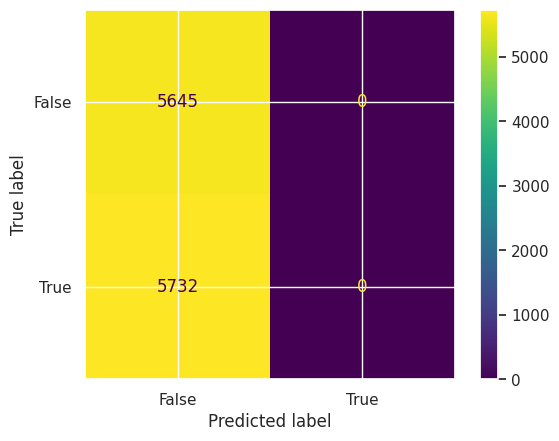

In [ ]:

from sklearn import metrics
confusion_matrix = metrics.confusion_matrix(y_test_np, y_pred)

cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = [False, True])
cm_display.plot()

fname300 = "cLNN.png"
plt.savefig(fname300, bbox_inches='tight', dpi=100)
plt.show()

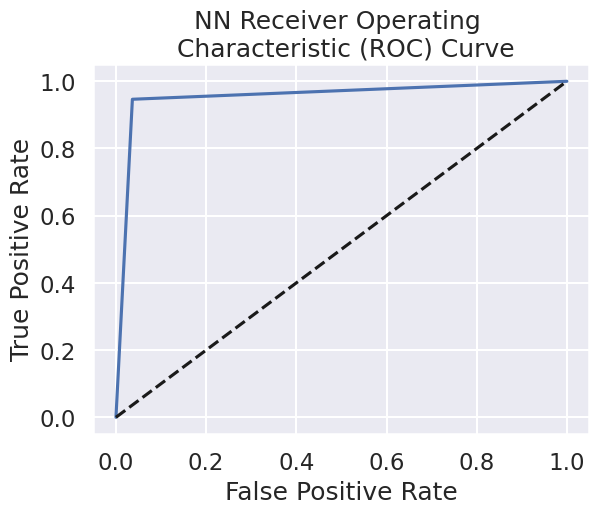

In [ ]:
# Plot the ROC curve
fpr, tpr, thresholds = metrics.roc_curve(y_test, y_predmlp)
plt.plot(fpr, tpr)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('NN Receiver Operating \n Characteristic (ROC) Curve')
fname250 = "AUCLmlp.png"
plt.savefig(fname250, bbox_inches='tight', dpi=100)
plt.show()

/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/backend/fork_exec.py:38: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid = os.fork()


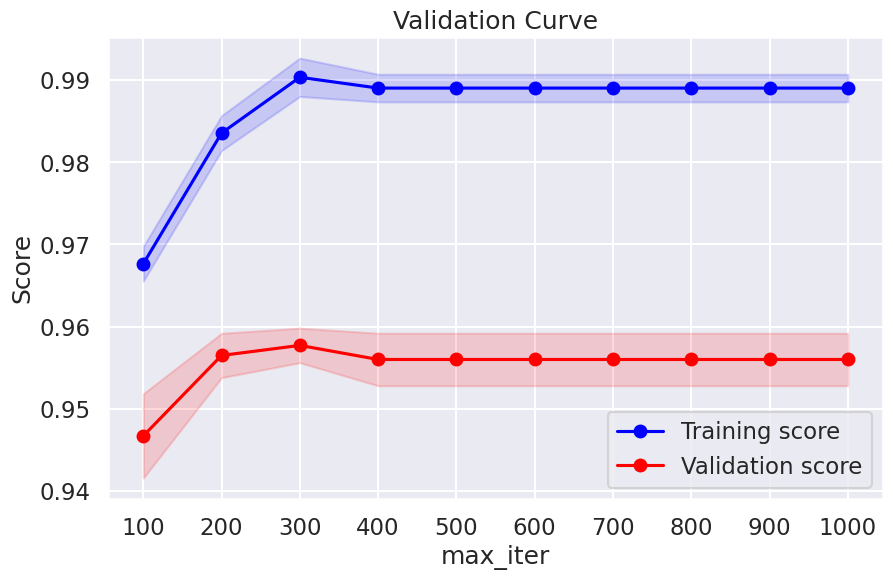

In [ ]:
import os
os.environ['JOBLIB_START_METHOD'] = 'forkserver'
from sklearn.model_selection import validation_curve

# Define the range of values for the max_iter hyperparameter
param_range = np.arange(100, 1001, 100)

# Compute training and validation scores using validation_curve
train_scores, valid_scores = validation_curve(
    MLPClassifier(hidden_layer_sizes=(100, 50), activation='relu', solver='adam', random_state=42),
    X_train_scaled, y_train, param_name='max_iter', param_range=param_range,
    cv=5, scoring='accuracy', n_jobs=-1
)

# Calculate the mean and standard deviation of training and validation scores
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)
valid_mean = np.mean(valid_scores, axis=1)
valid_std = np.std(valid_scores, axis=1)

# Plot the validation curve
plt.figure(figsize=(10, 6))
plt.plot(param_range, train_mean, label='Training score', color='blue', marker='o')
plt.fill_between(param_range, train_mean - train_std, train_mean + train_std, alpha=0.15, color='blue')
plt.plot(param_range, valid_mean, label='Validation score', color='red', marker='o')
plt.fill_between(param_range, valid_mean - valid_std, valid_mean + valid_std, alpha=0.15, color='red')
plt.title('Validation Curve')
plt.xlabel('max_iter')
plt.ylabel('Score')
plt.xticks(param_range)
plt.legend(loc='best')
plt.show()

In [ ]:
if xgb_model.xgb is None:
    print("The XGBoost model has not been trained.")
else:
    predictions = xgb_model.predict(X_test_scaled)

The XGBoost model has not been trained.


In [ ]:
y_pred = list()
y_prob = list()

coeff_labels = ["Random forest","SVM", 'XGBoost']
coeff_models = [RF, SVM, xgb_model]
for lab,mod in zip(coeff_labels, coeff_models):
    y_pred.append(pd.Series(mod.predict(X_test_scaled), name=lab))
    y_prob.append(pd.Series(mod.predict_proba(X_test_scaled).max(axis=1), name=lab))

y_pred = pd.concat(y_pred, axis=1)
y_prob = pd.concat(y_prob, axis=1)

y_pred.head()

AttributeError: 'NoneType' object has no attribute 'predict'

In [ ]:
from sklearn.metrics import precision_recall_fscore_support as score
metrics = list()
cm = dict()

for lab in coeff_labels:

    # Preciision, recall, f-score from the multi-class support function
    precision, recall, fscore, _ = score(y_test, y_pred[lab], average='weighted')

    # The usual way to calculate accuracy
    accuracy = accuracy_score(y_test, y_pred[lab])

    # ROC-AUC scores can be calculated by binarizing the data
    auc = roc_asc(label_binarize(y_test, classes=[0,1]),
              label_binarize(y_pred[lab], classes=[0,1]),
              average='weighted')



    metrics.append(pd.Series({'precision':precision, 'recall':recall,
                              'fscore':fscore, 'accuracy':accuracy,
                              'auc':auc},
                             name=lab))

metrics = pd.concat(metrics, axis=1)

In [ ]:
from sklearn.metrics import precision_recall_fscore_support as score
metrics = list()
cm = dict()

for lab in coeff_labels:

    # Preciision, recall, f-score from the multi-class support function
    precision, recall, fscore, _ = score(y_test, y_pred[lab], average='weighted')

    # The usual way to calculate accuracy
    accuracy = accuracy_score(y_test, y_pred[lab])

    # ROC-AUC scores can be calculated by binarizing the data
    auc = roc_asc(label_binarize(y_test, classes=[0,1]),
              label_binarize(y_pred[lab], classes=[0,1]),
              average='weighted')



    metrics.append(pd.Series({'precision':precision, 'recall':recall,
                              'fscore':fscore, 'accuracy':accuracy,
                              'auc':auc},
                             name=lab))

metrics = pd.concat(metrics, axis=1)

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from joblib import dump, load

X_train, X_test, y_train, y_test = train_test_split(X_f, y_res, test_size=0.3, random_state=42)

# Define the numeric features pipeline
numeric_features_pipeline = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),  # Impute missing values with median
    ('scaler', StandardScaler())  # Scale the features
])

# Create the full pipeline that includes preprocessing and Random Forest
rf_pipeline = Pipeline(steps=[('preprocessor', numeric_features_pipeline),
                              ('classifier', RandomForestClassifier(max_depth = 21, min_samples_split = 2, n_estimators = 267, max_features = 'log2', min_samples_leaf = 1, random_state=42))])

# Fit the pipeline to the training data
rf_pipeline.fit(X_train, y_train)

# Evaluate the model
score = rf_pipeline.score(X_test, y_test)
print(f"Model Accuracy: {score:.4f}")

Model Accuracy: 0.9998


In [ ]:
# Save the model
dump(rf_pipeline, 'random_forest_pipeline.joblib')

['random_forest_pipeline.joblib']

In [ ]:
from flask import Flask, request, jsonify
from joblib import load
import pandas as pd
import numpy as np

app = Flask(__name__)

In [ ]:
# Load the saved model
model = load('random_forest_pipeline.joblib')

@app.route('/predict', methods=['POST'])
def predict():
    # Get the data from the POST request
    data = request.get_json(force=True)

    # Convert JSON data to DataFrame
    # Ensure the order of columns matches the training data
    df = pd.DataFrame(data, index=[0])

    # Make prediction using the loaded model
    prediction = model.predict(df)

    # Convert prediction to list if it's not already
    if isinstance(prediction, np.ndarray):
        prediction = prediction.tolist()

    # Return the prediction as JSON
    return jsonify({'prediction': prediction})

if __name__ == '__main__':
    app.run(port=5000, debug=True)

 * Serving Flask app '__main__'
 * Debug mode: on


INFO:werkzeug:WARNING: This is a development server. Do not use it in a production deployment. Use a production WSGI server instead.
 * Running on http://127.0.0.1:5000
INFO:werkzeug:Press CTRL+C to quit
INFO:werkzeug: * Restarting with stat


In [ ]:
from flask import Flask, request, jsonify
from joblib import load
import os

app = Flask(__name__)

# Load the model when the application starts
model = load('random_forest_pipeline.joblib')

@app.route('/predict', methods=['POST'])
def predict():
    data = request.get_json(force=True)

    # Convert JSON data to DataFrame
    df = pd.DataFrame(data, index=[0])

    # Make prediction
    prediction = model.predict(df)

    # Convert prediction to list if it's not already
    if isinstance(prediction, np.ndarray):
        prediction = prediction.tolist()

    # Return the prediction as JSON
    return jsonify({'prediction': prediction})

if __name__ == '__main__':
    # This will run locally
    app.run(debug=True, port=int(os.environ.get('PORT', 5000)))

 * Serving Flask app '__main__'
 * Debug mode: on


INFO:werkzeug:WARNING: This is a development server. Do not use it in a production deployment. Use a production WSGI server instead.
 * Running on http://127.0.0.1:5000
INFO:werkzeug:Press CTRL+C to quit
INFO:werkzeug: * Restarting with stat


In [ ]:
import numpy as np
import pandas as pd
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.base import BaseEstimator, TransformerMixin
from joblib import dump, load
from imblearn.over_sampling import SMOTE
from sklearn.feature_selection import SelectFromModel
from imblearn.pipeline import Pipeline as ImbPipeline
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import SMOTE
from xgboost import XGBClassifier
from sklearn import set_config
# Disable HTML representation for unfitted estimators
set_config(display='text')

**Define Custom Transformers**

In [ ]:
import numpy as np
from sklearn.base import BaseEstimator, TransformerMixin

class DataCleaner(BaseEstimator, TransformerMixin):
    def __init__(self, threshold=1e300):
        self.threshold = threshold

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        # Remove rows with infinite values from X
        mask = ~np.isinf(X).any(axis=1)

        # Remove rows where any value exceeds the threshold
        mask &= ~(np.abs(X) > self.threshold).any(axis=1)

        # Remove rows with NaN values
        mask &= ~np.isnan(X).any(axis=1)

        X_cleaned = X[mask]

        # If y is provided, apply the same mask to y
        if y is not None:
            y_cleaned = y[mask]
            return X_cleaned, y_cleaned
        else:
            return X_cleaned

    def __sklearn_tags__(self):
        return {
            'binary_only': False,
            'multiclass': True,
            'multilabel': False,
            'multioutput': False,
            'requires_y': True,
            'poor_score': False,
            'allow_nan': False,
            'requires_fit': False,  # Note: DataCleaner doesn't actually require fitting
            'X_types': ['2darray'],
        }


class FeatureEngineer(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        try:
            # Calculate the magnitude of acceleration
            if all(col in X.columns for col in ['X', 'Y', 'Z']):
                X['Mag_Acc'] = np.sqrt(X['X']**2 + X['Y']**2 + X['Z']**2)
            else:
                raise KeyError("Missing one or more of X, Y, Z for calculating Mag_Acc")

            # Average Alpha, Beta, and Gamma
            for feature in ['Alpha', 'Beta', 'Gamma']:
                if f'{feature}1' in X.columns and f'{feature}2' in X.columns:
                    X[feature] = (X[f'{feature}1'] + X[f'{feature}2']) / 2
                else:
                    raise KeyError(f"Missing {feature}1 or {feature}2 for calculating {feature}")

            # Total of the frequency bands
            eeg_features = ['Gamma', 'Alpha', 'Theta', 'Beta','Delta']
            if all(feature in X.columns for feature in eeg_features):
                X['Total_Power'] = X[eeg_features].sum(axis=1)
            else:
                raise KeyError("Missing one or more EEG features for calculating Total_Power")

            # Calculate ratios, ensure division by zero is handled
            for feature in eeg_features:
                if feature in X.columns and 'Total_Power' in X.columns:
                    X[f'{feature}_ratio'] = np.divide(X[feature], X['Total_Power'], out=np.zeros_like(X[feature]), where=X['Total_Power']!=0)

            # Calculate additional features
            if 'Alpha' in X.columns and 'Theta' in X.columns:
                X['Alpha_Theta_Ratio'] = np.divide(X['Alpha'], X['Theta'], out=np.zeros_like(X['Alpha']), where=X['Theta']!=0)
            if 'Beta' in X.columns and 'Alpha' in X.columns:
                X['Beta_Minus_Alpha'] = X['Beta'] - X['Alpha']

            # Calculate Average_Power_EEG
            if all(feature in X.columns for feature in eeg_features):
                X['Average_Power_EEG'] = X[eeg_features].mean(axis=1)

            # Drop unnecessary columns
            to_drop = ['Beta1', 'Beta2', 'Alpha1', 'Alpha2', 'Gamma1', 'Gamma2',  'Attention', 'Meditation', 'Average_Power_EEG', 'Gamma', 'Alpha', 'Theta', 'Beta','Delta']
            X = X.drop([col for col in to_drop if col in X.columns], axis=1)

        except KeyError as e:
            print(f"KeyError: {e}. Please ensure all required columns or their components are present in your DataFrame.")
            raise

        # Replace any potential infinite or NaN values with finite numbers or appropriate values
        X = X.replace([np.inf, -np.inf], np.nan)
        X = X.fillna(X.median())
        return X
    def __sklearn_tags__(self):
        return {
            'binary_only': False,
            'multiclass': True,
            'multilabel': False,
            'multioutput': False,
            'requires_y': False,
            'poor_score': False,
            'allow_nan': False,
            'requires_fit': False,  # Feature engineering typically doesn't require fitting
            'X_types': ['2darray'],
        }


class ColumnSelector(BaseEstimator, TransformerMixin):
    def __init__(self, columns):
        self.columns = columns

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        # Check if all columns exist in X
        missing_columns = set(self.columns) - set(X.columns)
        if missing_columns:
            raise KeyError(f"Columns {missing_columns} are missing from the DataFrame.")
        return X[self.columns]
    def __sklearn_tags__(self):
        return {
            'binary_only': False,
            'multiclass': True,
            'multilabel': False,
            'multioutput': False,
            'requires_y': False,
            'poor_score': False,
            'allow_nan': False,
            'requires_fit': False,
            'X_types': ['2darray'],
        }

class XGBClassifierWrapper(BaseEstimator, ClassifierMixin):
    def __init__(self, **kwargs):
        self.model = XGBClassifier(**kwargs)

    def fit(self, X, y, **fit_params):
        self.model.fit(X, y, **fit_params)
        return self

    def predict(self, X):
        return self.model.predict(X)

    def predict_proba(self, X):
        return self.model.predict_proba(X)

    def __sklearn_tags__(self):
        return {
            'X_types': ['2darray'],
            'estimator_type': 'classifier',
            'allow_nan': False,
            'multioutput': False,
            'requires_fit': True
        }

In [ ]:
import numpy as np
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.base import BaseEstimator, ClassifierMixin
class DataCleaner(BaseEstimator, TransformerMixin):
    def __init__(self, threshold=1e300):
        self.threshold = threshold

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        # Remove rows with infinite values from X
        mask = ~np.isinf(X).any(axis=1)

        # Remove rows where any value exceeds the threshold
        mask &= ~(np.abs(X) > self.threshold).any(axis=1)

        # Remove rows with NaN values
        mask &= ~np.isnan(X).any(axis=1)

        X_cleaned = X[mask]

        # If y is provided, apply the same mask to y
        if y is not None:
            y_cleaned = y[mask]
            return X_cleaned, y_cleaned
        else:
            return X_cleaned



class FeatureEngineer(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        try:
            # Calculate the magnitude of acceleration
            if all(col in X.columns for col in ['X', 'Y', 'Z']):
                X['Mag_Acc'] = np.sqrt(X['X']**2 + X['Y']**2 + X['Z']**2)
            else:
                raise KeyError("Missing one or more of X, Y, Z for calculating Mag_Acc")

            # Average Alpha, Beta, and Gamma
            for feature in ['Alpha', 'Beta', 'Gamma']:
                if f'{feature}1' in X.columns and f'{feature}2' in X.columns:
                    X[feature] = (X[f'{feature}1'] + X[f'{feature}2']) / 2
                else:
                    raise KeyError(f"Missing {feature}1 or {feature}2 for calculating {feature}")

            # Total of the frequency bands
            eeg_features = ['Gamma', 'Alpha', 'Theta', 'Beta','Delta']
            if all(feature in X.columns for feature in eeg_features):
                X['Total_Power'] = X[eeg_features].sum(axis=1)
            else:
                raise KeyError("Missing one or more EEG features for calculating Total_Power")

            # Calculate ratios, ensure division by zero is handled
            for feature in eeg_features:
                if feature in X.columns and 'Total_Power' in X.columns:
                    X[f'{feature}_ratio'] = np.divide(X[feature], X['Total_Power'], out=np.zeros_like(X[feature]), where=X['Total_Power']!=0)

            # Calculate additional features
            if 'Alpha' in X.columns and 'Theta' in X.columns:
                X['Alpha_Theta_Ratio'] = np.divide(X['Alpha'], X['Theta'], out=np.zeros_like(X['Alpha']), where=X['Theta']!=0)
            if 'Beta' in X.columns and 'Alpha' in X.columns:
                X['Beta_Minus_Alpha'] = X['Beta'] - X['Alpha']

            # Calculate Average_Power_EEG
            if all(feature in X.columns for feature in eeg_features):
                X['Average_Power_EEG'] = X[eeg_features].mean(axis=1)

            # Drop unnecessary columns
            to_drop = ['Beta1', 'Beta2', 'Alpha1', 'Alpha2', 'Gamma1', 'Gamma2',  'Attention', 'Meditation', 'Average_Power_EEG', 'Gamma', 'Alpha', 'Theta', 'Beta','Delta']
            X = X.drop([col for col in to_drop if col in X.columns], axis=1)

        except KeyError as e:
            print(f"KeyError: {e}. Please ensure all required columns or their components are present in your DataFrame.")
            raise

        # Replace any potential infinite or NaN values with finite numbers or appropriate values
        X = X.replace([np.inf, -np.inf], np.nan)
        X = X.fillna(X.median())
        return X

class ColumnSelector(BaseEstimator, TransformerMixin):
    def __init__(self, columns):
        self.columns = columns

    def fit(self, X, y=None):
        return self

    def transform(self, X):
        # Check if all columns exist in X
        missing_columns = set(self.columns) - set(X.columns)
        if missing_columns:
            raise KeyError(f"Columns {missing_columns} are missing from the DataFrame.")
        return X[self.columns]


class XGBClassifierWrapper(BaseEstimator, ClassifierMixin):
    def __init__(self, **kwargs):
        self.model = XGBClassifier(**kwargs)

    def fit(self, X, y, **fit_params):
        self.model.fit(X, y, **fit_params)
        return self

    def predict(self, X):
        return self.model.predict(X)

    def predict_proba(self, X):
        return self.model.predict_proba(X)


In [ ]:
print(xgb_pipeline.named_steps)

{'selector': ColumnSelector(columns=['BVP', 'EDA', 'TEMP', 'X', 'Y', 'Z', 'HR', 'Delta',
                        'Theta', 'Alpha1', 'Alpha2', 'Beta1', 'Beta2', 'Gamma1',
                        'Gamma2', 'Attention', 'Meditation']), 'feature_engineer': FeatureEngineer(), 'cleaner': DataCleaner(), 'scaler': StandardScaler(), 'smote': SMOTE(random_state=42), 'classifier': XGBClassifierWrapper()}


In [ ]:
# Example
X_selected = xgb_pipeline.named_steps['selector'].transform(X_test)
X_engineered = xgb_pipeline.named_steps['feature_engineer'].transform(X_selected)
X_cleaned = xgb_pipeline.named_steps['cleaner'].transform(X_engineered)
X_scaled = xgb_pipeline.named_steps['scaler'].transform(X_cleaned)
X_resampled, y_resampled = xgb_pipeline.named_steps['smote'].fit_resample(X_scaled, y_test)


In [ ]:
X_resampled.shape

(10130, 16)

In [ ]:
def detect_outliers_iqr(dataframe, column):

    Q1 = dataframe[column].quantile(0.25)
    Q3 = dataframe[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = (dataframe[column] < lower_bound) | (dataframe[column] > upper_bound)
    return outliers

# Assuming 'f_df' is your DataFrame and you want to check for outliers in all columns except 'class'
columns_to_check = [col for col in S_df.columns if col != 'class']

# Dictionary to store outliers for each column
outliers_dict = {}

for column in columns_to_check:
    outliers = detect_outliers_iqr(S_df, column)
    outliers_dict[column] = outliers
    print(f"Number of outliers in {column}: {outliers.sum()}")

    # Optionally, to see which rows are outliers
    outlier_rows = S_df[outliers]
    print(f"Rows with outliers in {column}:")
    print(outlier_rows[[column]].head())  # Show first few rows with outliers for this column

for column, outliers in outliers_dict.items():
    S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
print(S_df.shape)
# Assuming you have a DataFrame 'S_df' and a target variable
# X contains features, y contains the target variable
X = S_df.drop('class', axis=1)  # Replace 'target' with your actual target column name
y = S_df['class']
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define feature names for the original dataset
# Include all features that will be used in the transformations
original_features = ['BVP', 'EDA', 'TEMP', 'X', 'Y', 'Z', 'HR', 'Delta',
                     'Theta', 'Alpha1','Alpha2', 'Beta1', 'Beta2', 'Gamma1',
                     'Gamma2', 'Attention', 'Meditation']

# Define the pipeline
rf_pipeline = ImbPipeline([
    # Select original features
    ('selector', ColumnSelector(original_features)),
    # Custom feature engineering
    ('feature_engineer', FeatureEngineer()),
    # Clean data (remove infinite values)
    ('cleaner', DataCleaner()),
    # Scale the features
    ('scaler', StandardScaler()),
    # SMOTE for handling imbalanced data
    ('smote', SMOTE(random_state=42)),
    # Random Forest Classifier
    ('classifier', RandomForestClassifier(max_depth=21, min_samples_split=2,
                                          n_estimators=267, max_features='log2',
                                          min_samples_leaf=1, random_state=42))
])

# Fit the pipeline to the training data
rf_pipeline.fit(X_train, y_train)

# Evaluate the model
score = rf_pipeline.score(X_test, y_test)
print(f"Model Accuracy: {score:.4f}")

ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 2 dimensions. The detected shape was (2, 367009) + inhomogeneous part.

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.base import BaseEstimator, ClassifierMixin
import numpy as np
from sklearn.utils import check_X_y, check_array
from sklearn.preprocessing import FunctionTransformer
from sklearn.base import clone

In [ ]:
class StackingClassifier(BaseEstimator, ClassifierMixin):
    def __init__(self, base_estimators, meta_estimator):
        self.base_estimators = base_estimators
        self.meta_estimator = meta_estimator

    def fit(self, X, y):
        X, y = check_X_y(X, y)
        self.base_estimators_ = [clone(est) for est in self.base_estimators]

        # Fit base estimators and predict on training data
        X_meta = np.column_stack([
            est.fit(X, y).predict_proba(X) for est in self.base_estimators_
        ])

        self.meta_estimator_ = clone(self.meta_estimator)
        self.meta_estimator_.fit(X_meta, y)
        return self

    def predict(self, X):
        X = check_array(X)
        X_meta = np.column_stack([
            est.predict_proba(X) for est in self.base_estimators_
        ])
        return self.meta_estimator_.predict(X_meta)

    def predict_proba(self, X):
        X = check_array(X)
        X_meta = np.column_stack([
            est.predict_proba(X) for est in self.base_estimators_
        ])
        return self.meta_estimator_.predict_proba(X_meta)

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import SMOTE
from xgboost import XGBClassifier
from sklearn import set_config
from sklearn.metrics import accuracy_score
# Disable HTML representation for unfitted estimators
set_config(display='text')

def detect_outliers_iqr(dataframe, column):
    Q1 = dataframe[column].quantile(0.25)
    Q3 = dataframe[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = (dataframe[column] < lower_bound) | (dataframe[column] > upper_bound)
    return outliers

# Assuming 'S_df' is your DataFrame and you want to check for outliers in all columns except 'class'
columns_to_check = [col for col in S_df.columns if col != 'class']

# Dictionary to store outliers for each column
outliers_dict = {}

for column in columns_to_check:
    outliers = detect_outliers_iqr(S_df, column)
    outliers_dict[column] = outliers
    print(f"Number of outliers in {column}: {outliers.sum()}")

    # Optionally, to see which rows are outliers
    outlier_rows = S_df[outliers]
    print(f"Rows with outliers in {column}:")
    print(outlier_rows[[column]].head())  # Show first few rows with outliers for this column

# Remove outliers from the DataFrame
for column, outliers in outliers_dict.items():
    S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
print(S_df.shape)

# Assuming you have a DataFrame 'S_df' and a target variable
# X contains features, y contains the target variable
X = S_df.drop('class', axis=1)  # Replace 'class' with your actual target column name if different
y = S_df['class']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define feature names for the original dataset
# Include all features that will be used in the transformations
original_features = ['BVP', 'EDA', 'TEMP', 'X', 'Y', 'Z', 'HR', 'Delta',
                     'Theta', 'Alpha1', 'Alpha2', 'Beta1', 'Beta2', 'Gamma1',
                     'Gamma2', 'Attention', 'Meditation']


Number of outliers in BVP: 118160
Rows with outliers in BVP:
         BVP
37 -0.028146
38 -0.011309
39  0.003061
40  0.014137
41  0.021698
Number of outliers in EDA: 67122
Rows with outliers in EDA:
           EDA
3391  0.130767
3392  0.130767
3393  0.130767
3394  0.130767
3395  0.130767
Number of outliers in TEMP: 0
Rows with outliers in TEMP:
Empty DataFrame
Columns: [TEMP]
Index: []
Number of outliers in X: 15322
Rows with outliers in X:
              X
47011  0.184314
47012  0.184314
47083  0.184314
47084  0.184314
47085  0.184314
Number of outliers in Y: 158351
Rows with outliers in Y:
             Y
2993  0.301961
2994  0.301961
3273  0.286275
3274  0.286275
3275  0.294118
Number of outliers in Z: 2199
Rows with outliers in Z:
              Z
3665  -0.490196
3666  -0.490196
46975 -0.498039
46976 -0.498039
46979 -0.521569
Number of outliers in HR: 3198
Rows with outliers in HR:
             HR
49791  0.756946
49792  0.756946
49793  0.756946
49794  0.756946
49795  0.756946
Number o

<ipython-input-12-cfb9b86b53ba>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-12-cfb9b86b53ba>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-12-cfb9b86b53ba>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-12-cfb9b86b53ba>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-12-cfb9b86b53ba>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-12-cfb9b86b53ba>:39:

(393809, 18)


<ipython-input-12-cfb9b86b53ba>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-12-cfb9b86b53ba>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-12-cfb9b86b53ba>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-12-cfb9b86b53ba>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-12-cfb9b86b53ba>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier


In [ ]:
# Define base models
xgb = XGBClassifier(
    colsample_bytree=0.74981,
    gamma=0.190142,
    learning_rate=0.15639,
    max_depth=3,
    n_estimators=120,
    reg_alpha=0.78009,
    reg_lambda=1.77997,
    subsample=0.6232337,
    random_state=42,
    use_label_encoder=False,
    eval_metric='logloss'
)
rf = RandomForestClassifier(max_depth=21, min_samples_split=2,
                                          n_estimators=267, max_features='log2',
                                          min_samples_leaf=1, random_state=42)

# Define meta model
meta_model = LogisticRegression(random_state=42)

# Stack them
stacking_model = StackingClassifier(base_estimators=[xgb, rf], meta_estimator=meta_model)

# Define the pipeline with the stacking model
hybrid_pipeline = ImbPipeline([
    ('selector', ColumnSelector(original_features)),
    ('feature_engineer', FeatureEngineer()),
    ('cleaner', DataCleaner()),
    ('scaler', StandardScaler()),
    ('smote', SMOTE(random_state=42)),
    ('classifier', stacking_model),
])

# Fit the pipeline to the training data
hybrid_pipeline.fit(X_train, y_train)

# Predict on the test set
y_pred = hybrid_pipeline.predict(X_test)

# Calculate accuracy
score = accuracy_score(y_test, y_pred)
print(f"Hybrid Model Accuracy: {score:.4f}")

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/utils/_tags.py:354: FutureWarning: The SMOTE or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [07:01:53] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warni

Hybrid Model Accuracy: 1.0000


In [ ]:
# Access the classifier from the pipeline
classifier = hybrid_pipeline.named_steps['classifier']

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import precision_recall_fscore_support as score
from sklearn.model_selection import learning_curve, validation_curve
from sklearn import metrics
from sklearn.preprocessing import RobustScaler
# import train_test_split so we can split our data into train and test
from sklearn.model_selection import train_test_split

# import the LogReg model from sklearn
from sklearn.linear_model import LogisticRegression
# import the 'metrics' module, which includes important metrics we may want to use
from sklearn import metrics
from sklearn.metrics import classification_report, accuracy_score, f1_score, confusion_matrix, precision_recall_fscore_support, precision_score, recall_score, roc_auc_score
from sklearn.preprocessing import label_binarize
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier
from sklearn.datasets import make_classification
import tensorflow as tf
import keras
import xgboost as xgb
from imblearn.over_sampling import SMOTE
from sklearn.datasets import make_classification
from collections import Counter
from sklearn.feature_selection import RFE
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from scipy.stats import randint


In [ ]:
y_predHB = list()
y_probHB = list()

coeff_labels = ['Hybrid_model']
coeff_models = [classifier]

for lab,mod in zip(coeff_labels, coeff_models):
    y_predHB.append(pd.Series(mod.predict(X_resampledt), name=lab))
    y_probHB.append(pd.Series(mod.predict_proba(X_resampledt).max(axis=1), name=lab))

y_predHB = pd.concat(y_predHB, axis=1)
y_probHB = pd.concat(y_probHB, axis=1)

y_predHB.head()

,Hybrid_model
0,0
1,1
2,1
3,1
4,0


In [ ]:
from sklearn.metrics import precision_recall_fscore_support as score
HBmetrics = list()
HBcm = dict()

for lab in coeff_labels:

    # Preciision, recall, f-score from the multi-class support function
    precision, recall, fscore, _ = score(y_resampledt, y_predHB[lab], average='weighted')

    # The usual way to calculate accuracy
    accuracy = accuracy_score(y_resampledt, y_predHB[lab])

    # ROC-AUC scores can be calculated by binarizing the data
    auc = roc_auc_score(label_binarize(y_resampledt, classes=[0,1]),
              label_binarize(y_predHB[lab], classes=[0,1]),
              average='weighted')


    HBmetrics.append(pd.Series({'precision':precision, 'recall':recall,
                              'fscore':fscore, 'accuracy':accuracy,
                              'auc':auc},
                             name=lab))

HBmetrics = pd.concat(HBmetrics, axis=1)

In [ ]:
HBmetrics

,Hybrid_model
precision,0.999565
recall,0.999565
fscore,0.999565
accuracy,0.999565
auc,0.999565


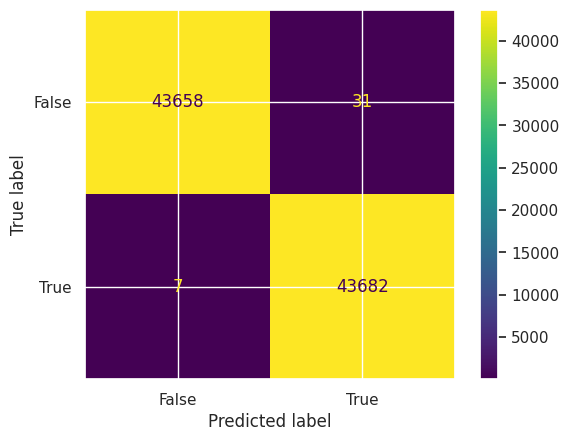

In [ ]:
from sklearn.metrics import roc_curve, auc as roc_auc
import matplotlib.pyplot as plt

from sklearn.multiclass import OneVsRestClassifier
from sklearn.preprocessing import label_binarize
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

from sklearn import metrics
confusion_matrix = metrics.confusion_matrix(y_resampledt, y_predHB)

cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix, display_labels = [False, True])
cm_display.plot()

plt.show()

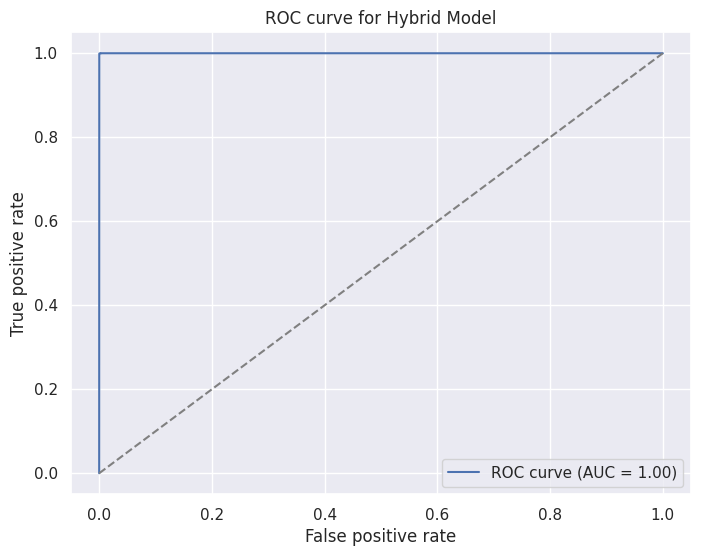

In [ ]:
# Predict the probabilities of the positive class on the test set.
from sklearn.metrics import roc_auc_score, roc_curve, auc

y_proba_HB = classifier.predict_proba(X_resampledt)[:, 1]

# Compute the ROC curve and the AUC score.
fpr, tpr, thresholds = roc_curve(y_resampledt, y_proba_HB)
auc_score = roc_auc_score(y_resampledt, y_proba_HB)
auc_value = auc(fpr, tpr)

# Plot the ROC curve and show the AUC score.
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC curve (AUC = {auc_score:.2f})')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve for Hybrid Model')
plt.legend()
plt.show()

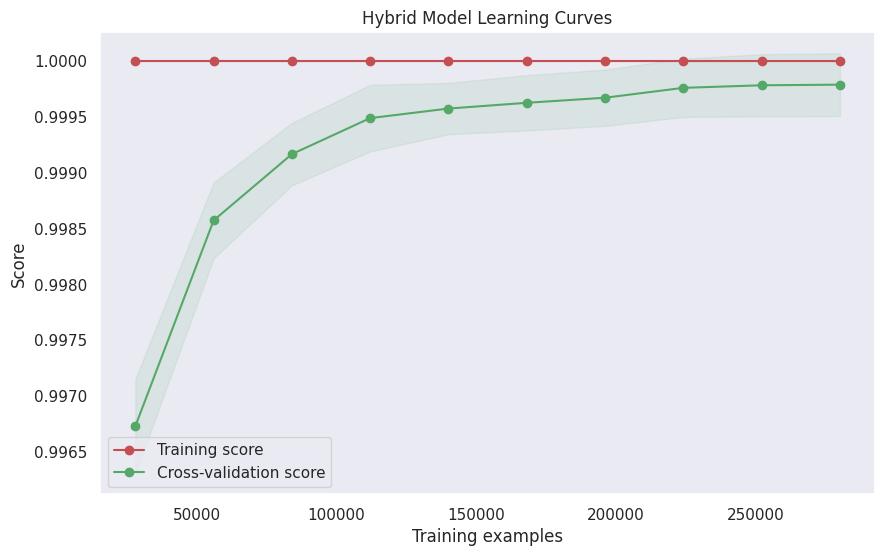

In [ ]:
from sklearn.model_selection import learning_curve

train_sizes, train_scores, val_scores = learning_curve(
    classifier, X_resampled, y_resampled, train_sizes=np.linspace(0.1, 1.0, 10), cv=5, scoring='accuracy', n_jobs=-1)

# Plotting learning curves
import matplotlib.pyplot as plt

train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
val_scores_mean = np.mean(val_scores, axis=1)
val_scores_std = np.std(val_scores, axis=1)

plt.figure(figsize=(10, 6))
plt.title("Hybrid Model Learning Curves")
plt.xlabel("Training examples")
plt.ylabel("Score")
plt.grid()

plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color="r")
plt.fill_between(train_sizes, val_scores_mean - val_scores_std, val_scores_mean + val_scores_std, alpha=0.1, color="g")
plt.plot(train_sizes, train_scores_mean, 'o-', color="r", label="Training score")
plt.plot(train_sizes, val_scores_mean, 'o-', color="g", label="Cross-validation score")
plt.legend(loc="best")
plt.show()

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from imblearn.pipeline import Pipeline as ImbPipeline
from imblearn.over_sampling import SMOTE
from xgboost import XGBClassifier
from sklearn import set_config
from sklearn.metrics import accuracy_score
# Disable HTML representation for unfitted estimators
set_config(display='text')

def detect_outliers_iqr(dataframe, column):
    Q1 = dataframe[column].quantile(0.25)
    Q3 = dataframe[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = (dataframe[column] < lower_bound) | (dataframe[column] > upper_bound)
    return outliers

# Assuming 'S_df' is your DataFrame and you want to check for outliers in all columns except 'class'
columns_to_check = [col for col in S_df.columns if col != 'class']

# Dictionary to store outliers for each column
outliers_dict = {}

for column in columns_to_check:
    outliers = detect_outliers_iqr(S_df, column)
    outliers_dict[column] = outliers
    print(f"Number of outliers in {column}: {outliers.sum()}")

    # Optionally, to see which rows are outliers
    outlier_rows = S_df[outliers]
    print(f"Rows with outliers in {column}:")
    print(outlier_rows[[column]].head())  # Show first few rows with outliers for this column

# Remove outliers from the DataFrame
for column, outliers in outliers_dict.items():
    S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
print(S_df.shape)

# Assuming you have a DataFrame 'S_df' and a target variable
# X contains features, y contains the target variable
X = S_df.drop('class', axis=1)  # Replace 'class' with your actual target column name if different
y = S_df['class']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define feature names for the original dataset
# Include all features that will be used in the transformations
original_features = ['BVP', 'EDA', 'TEMP', 'X', 'Y', 'Z', 'HR', 'Delta',
                     'Theta', 'Alpha1', 'Alpha2', 'Beta1', 'Beta2', 'Gamma1',
                     'Gamma2', 'Attention', 'Meditation']

# Define the pipeline with XGBoost
xgb_pipeline = ImbPipeline([
    # Select original features
    ('selector', ColumnSelector(original_features)),
    # Custom feature engineering
    ('feature_engineer', FeatureEngineer()),
    # Clean data (remove infinite values)
    ('cleaner', DataCleaner()),
    # Scale the features
    ('scaler', StandardScaler()),
    # SMOTE for handling imbalanced data
    ('smote', SMOTE(random_state=42)),
    # XGBoost Classifier with specified hyperparameters
     ('classifier', XGBClassifierWrapper(
        colsample_bytree=0.74981,
        gamma=0.190142,
        learning_rate=0.15639,
        max_depth=3,
        n_estimators=120,
        reg_alpha=0.78009,
        reg_lambda=1.77997,
        subsample=0.6232337,
        random_state=42,
        use_label_encoder=False,
        eval_metric='logloss'
    ))
])

# Fit the pipeline to the training data
xgb_pipeline.fit(X_train, y_train)

# Predict on the test set
y_pred = xgb_pipeline.predict(X_test)

# Calculate accuracy manually
score = accuracy_score(y_test, y_pred)
print(f"Model Accuracy: {score:.4f}")

Number of outliers in BVP: 118160
Rows with outliers in BVP:
         BVP
37 -0.028146
38 -0.011309
39  0.003061
40  0.014137
41  0.021698
Number of outliers in EDA: 67122
Rows with outliers in EDA:
           EDA
3391  0.130767
3392  0.130767
3393  0.130767
3394  0.130767
3395  0.130767
Number of outliers in TEMP: 0
Rows with outliers in TEMP:
Empty DataFrame
Columns: [TEMP]
Index: []
Number of outliers in X: 15322
Rows with outliers in X:
              X
47011  0.184314
47012  0.184314
47083  0.184314
47084  0.184314
47085  0.184314
Number of outliers in Y: 158351
Rows with outliers in Y:
             Y
2993  0.301961
2994  0.301961
3273  0.286275
3274  0.286275
3275  0.294118
Number of outliers in Z: 2199
Rows with outliers in Z:
              Z
3665  -0.490196
3666  -0.490196
46975 -0.498039
46976 -0.498039
46979 -0.521569
Number of outliers in HR: 3198
Rows with outliers in HR:
             HR
49791  0.756946
49792  0.756946
49793  0.756946
49794  0.756946
49795  0.756946
Number o

<ipython-input-9-b859f2a0f8e9>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-9-b859f2a0f8e9>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-9-b859f2a0f8e9>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-9-b859f2a0f8e9>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-9-b859f2a0f8e9>:39: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  S_df = S_df[~outliers]  # Keep only the rows where the value is not an outlier
<ipython-input-9-b859f2a0f8e9>:39: UserW

(393809, 18)


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [11:40:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Model Accuracy: 0.9723


/usr/local/lib/python3.10/dist-packages/imblearn/pipeline.py:65: FutureWarning: This Pipeline instance is not fitted yet. Call 'fit' with appropriate arguments before using other methods such as transform, predict, etc. This will raise an error in 0.15 instead of the current warning.
  warnings.warn(


In [ ]:
# Initialize the XGBoost classifier with the specified parameters for CPU
xgb_model = XGBClassifier(
    colsample_bytree=0.749816047538945,
    gamma=0.19014286128198324,
    learning_rate=0.15639878836228102,
    max_depth=3,
    n_estimators=120,
    reg_alpha=0.7800932022121826,
    reg_lambda=1.7799726016810133,
    subsample=0.6232334448672797,
    random_state=42
)

# Train the model
xgb_model.fit(X_train, y_train)

In [ ]:
import shap

# Assuming 'model' is your trained model, 'X_train' is your training data

# Create object that can calculate shap values
explainer = shap.TreeExplainer(model)  # For tree-based models like XGBoost or Random Forests
shap_values = explainer.shap_values(X_train)

# Plot summary plot which gives an overview of feature importance
shap.summary_plot(shap_values, X_train, plot_type="bar")

# For a more detailed view of feature impact across different instances:
shap.summary_plot(shap_values, X_train)

In [ ]:
X_train.head()

,BVP,EDA,TEMP,X,Y,Z,HR,Delta,Theta,Alpha1,Alpha2,Beta1,Beta2,Gamma1,Gamma2,Attention,Meditation
214801,-0.068362,-0.904617,0.872941,-0.090196,-0.082353,0.035294,0.608024,0.030178,0.054261,0.000001,0.004160,0.000902,0.005697,0.107138,0.012342,0.010101,0.030303
793710,-0.079669,-0.809840,0.604706,-0.466667,-0.003922,-0.200000,0.417164,0.075353,0.007267,0.000237,0.030231,0.114251,0.000678,0.003838,0.103739,1.000000,0.959596
438282,-0.094995,-0.970575,-0.364706,-0.333333,-0.105882,0.388235,0.109063,0.001562,0.075717,0.001552,0.000078,0.010398,0.003122,0.052907,0.000488,0.232323,0.616162
963467,-0.084680,-0.821498,0.256471,-0.521569,0.003922,0.003922,0.005193,0.001525,0.003244,0.166144,0.000010,0.110962,0.030795,0.052987,0.041026,0.979798,0.202020
450481,-0.057544,-0.963494,-0.115294,-0.207843,-0.105882,0.466667,0.064529,0.000640,0.020405,0.046130,0.034782,0.008815,0.089753,0.025002,0.000007,0.424242,0.898990


In [ ]:
# Save the model
dump(rf_pipeline, 'random_forest2_pipeline.joblib')

['random_forest2_pipeline.joblib']

In [ ]:
# Save the model
dump(xgb_pipeline, 'Xgb_pipeline.joblib')

['Xgb_pipeline.joblib']

In [ ]:
# Save the model
dump(hybrid_pipeline, 'hybrid_pipeline.joblib')

['hybrid_pipeline.joblib']

In [ ]:
print("Before Pipeline:")
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)

# Apply each step of the pipeline individually to understand where the mismatch happens

# Step 1: Column Selection
X_selected = hybrid_pipeline.named_steps['selector'].transform(X_train)
print("\nAfter Column Selection:")
print("X_selected shape:", X_selected.shape)

# Step 2: Data Cleaning
X_cleaned, y_cleaned = hybrid_pipeline.named_steps['cleaner'].transform(X_selected, y_train)
print("\nAfter Data Cleaning:")
print("X_cleaned shape:", X_cleaned.shape)
print("y_cleaned shape:", y_cleaned.shape)

# Step 3: Feature Engineering
X_engineered = hybrid_pipeline.named_steps['feature_engineer'].transform(X_cleaned)
print("\nAfter Feature Engineering:")
print("X_engineered shape:", X_engineered.shape)


# Step 5: Scaling
X_scaled = hybrid_pipeline.named_steps['scaler'].fit_transform(X_engineered)
print("\nAfter Scaling:")
print("X_scaled shape:", X_scaled.shape)


smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_scaled, y_cleaned)

Before Pipeline:
X_train shape: (315047, 17)
y_train shape: (315047,)

After Column Selection:
X_selected shape: (315047, 17)

After Data Cleaning:
X_cleaned shape: (315047, 17)
y_cleaned shape: (315047,)

After Feature Engineering:
X_engineered shape: (315047, 16)

After Scaling:
X_scaled shape: (315047, 16)


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/utils/_tags.py:354: FutureWarning: The SMOTE or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(


In [ ]:
print("Before Pipeline:")
print("X_train shape:", X_test.shape)
print("y_train shape:", y_test.shape)

# Apply each step of the pipeline individually to understand where the mismatch happens

# Step 1: Column Selection
X_selectedt = hybrid_pipeline.named_steps['selector'].transform(X_test)
print("\nAfter Column Selection:")
print("X_selected shape:", X_selectedt.shape)

# Step 2: Data Cleaning
X_cleanedt, y_cleanedt = hybrid_pipeline.named_steps['cleaner'].transform(X_selectedt, y_test)
print("\nAfter Data Cleaning:")
print("X_cleaned shape:", X_cleanedt.shape)
print("y_cleaned shape:", y_cleanedt.shape)

# Step 3: Feature Engineering
X_engineeredt = hybrid_pipeline.named_steps['feature_engineer'].transform(X_cleanedt)
print("\nAfter Feature Engineering:")
print("X_engineered shape:", X_engineeredt.shape)


# Step 5: Scaling
X_scaledt = hybrid_pipeline.named_steps['scaler'].fit_transform(X_engineeredt)
print("\nAfter Scaling:")
print("X_scaled shape:", X_scaledt.shape)

# Step 5: Scaling
# Fit and resample
smote = SMOTE(random_state=42)
X_resampledt, y_resampledt = smote.fit_resample(X_scaledt, y_cleanedt)




Before Pipeline:
X_train shape: (78762, 17)
y_train shape: (78762,)

After Column Selection:
X_selected shape: (78762, 17)

After Data Cleaning:
X_cleaned shape: (78762, 17)
y_cleaned shape: (78762,)

After Feature Engineering:
X_engineered shape: (78762, 16)

After Scaling:
X_scaled shape: (78762, 16)


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:474: FutureWarning: `BaseEstimator._validate_data` is deprecated in 1.6 and will be removed in 1.7. Use `sklearn.utils.validation.validate_data` instead. This function becomes public and is part of the scikit-learn developer API.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/utils/_tags.py:354: FutureWarning: The SMOTE or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(


In [ ]:
# Initialize the XGBoost classifier with the specified parameters for CPU
xgb_model = XGBClassifier(
    colsample_bytree=0.749816047538945,
    gamma=0.19014286128198324,
    learning_rate=0.15639878836228102,
    max_depth=3,
    n_estimators=120,
    reg_alpha=0.7800932022121826,
    reg_lambda=1.7799726016810133,
    subsample=0.6232334448672797,
    random_state=42
)

# Train the model
xgb_model.fit(X_resampled, y_resampled)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.749816047538945, device=None,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0.19014286128198324,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.15639878836228102,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=3, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=120, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

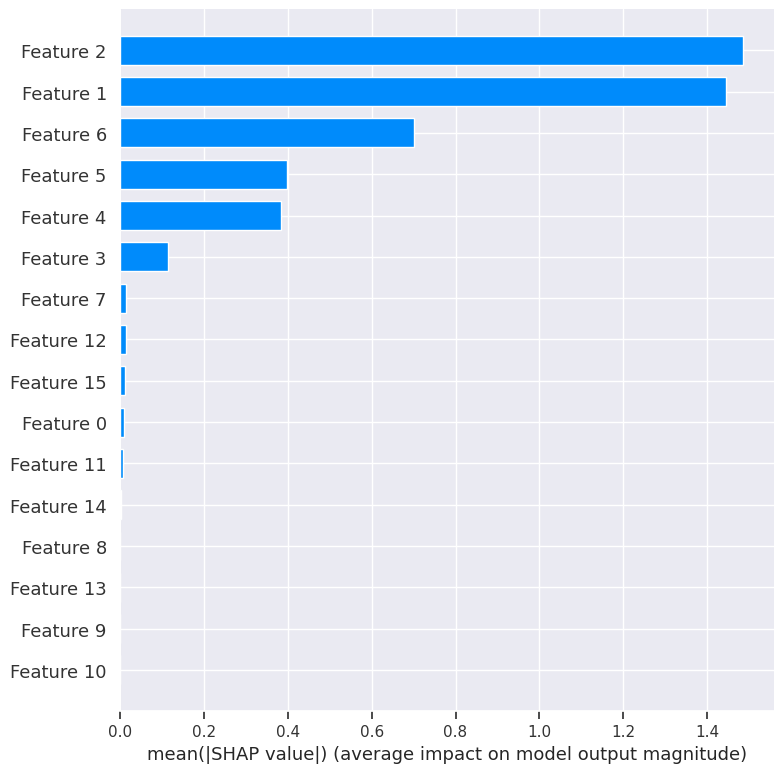

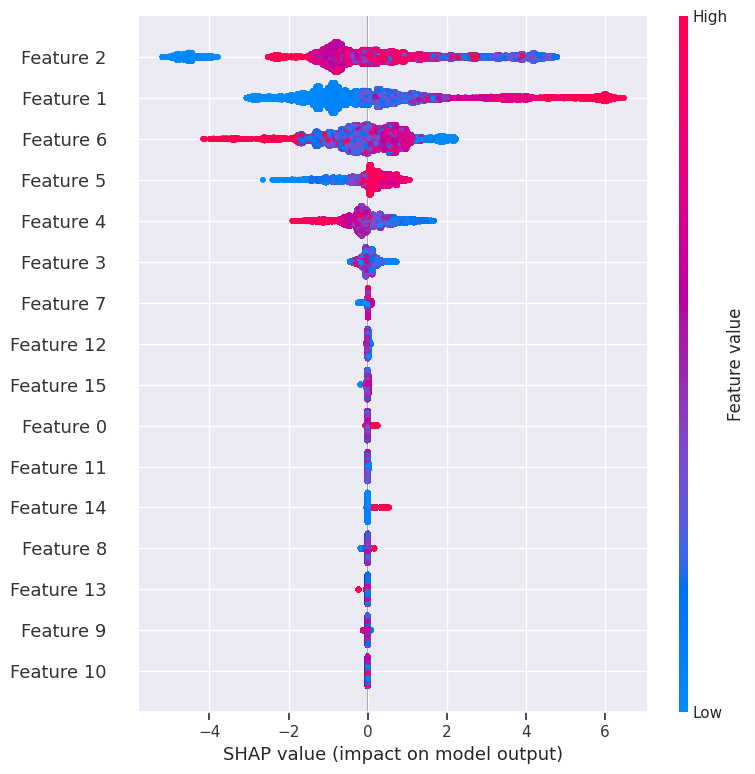

In [ ]:
import shap

# Assuming 'model' is your trained model, 'X_train' is your training data

# Create object that can calculate shap values
explainer = shap.TreeExplainer(xgb_model)  # For tree-based models like XGBoost or Random Forests
shap_values = explainer.shap_values(X_resampled)

# Plot summary plot which gives an overview of feature importance
shap.summary_plot(shap_values, X_resampled, plot_type="bar")

# For a more detailed view of feature impact across different instances:
shap.summary_plot(shap_values, X_resampled) #classifier

In [ ]:
import shap

# Assuming 'xgb_model' is your trained model, 'X_resampled' is your resampled training data

# Create object that can calculate shap values
explainer = shap.TreeExplainer(xgb_model)
shap_values = explainer.shap_values(X_resampled)

# Use actual feature names
feature_names = X_engineered.columns  # Assuming X_resampled is a DataFrame with named columns

# Plot summary plot which gives an overview of feature importance
shap.summary_plot(shap_values, X_resampled, plot_type="bar", feature_names=feature_names)

# For a more detailed view of feature impact across different instances:
shap.summary_plot(shap_values, X_resampled, feature_names=feature_names)

In [ ]:
corr_values = data.corr()
corr_values
# Simplify by emptying all the data below the diagonal
tril_index = np.tril_indices_from(corr_values)

# Make the unused values NaNs
for coord in zip(*tril_index):
    corr_values.iloc[coord[0], coord[1]] = np.NaN

# Stack the data and convert to a data frame
corr_values = (corr_values
               .stack()
               .to_frame()
               .reset_index()
               .rename(columns={'level_0':'feature1',
                                'level_1':'feature2',
                                0:'correlation'}))

# Get the absolute values for sorting
corr_values['abs_correlation'] = corr_values.correlation.abs()

In [ ]:
corr_values.head()

,feature1,feature2,correlation,abs_correlation
0,BVP,EDA,0.013355,0.013355
1,BVP,TEMP,0.006032,0.006032
2,BVP,X,0.003596,0.003596
3,BVP,Y,0.000971,0.000971
4,BVP,Z,0.012943,0.012943


In [ ]:
corr_values.to_csv('correlation_values.csv', index=True)

In [ ]:
corr_values2 = S_df.corr()
corr_values2
# Simplify by emptying all the data below the diagonal
tril_index = np.tril_indices_from(corr_values2)

# Make the unused values NaNs
for coord in zip(*tril_index):
    corr_values2.iloc[coord[0], coord[1]] = np.NaN

# Stack the data and convert to a data frame
corr_values2 = (corr_values2
               .stack()
               .to_frame()
               .reset_index()
               .rename(columns={'level_0':'feature1',
                                'level_1':'feature2',
                                0:'correlation'}))

# Get the absolute values for sorting
corr_values2['abs_correlation'] = corr_values2.correlation.abs()

In [ ]:
corr_values2.to_csv('correlation_values2.csv', index=True)

In [ ]:
data.columns

Index(['BVP', 'EDA', 'TEMP', 'X', 'Y', 'Z', 'HR', 'Mag_Acc', 'Total_Power',
       'Gamma_ratio', 'Alpha_ratio', 'Theta_ratio', 'Beta_ratio',
       'Delta_ratio', 'Alpha_Theta_Ratio', 'Beta_Minus_Alpha', 'class'],
      dtype='object')

In [ ]:
data = data.rename(columns={'class': 'categorical_var'})

In [ ]:
data.columns

Index(['BVP', 'EDA', 'TEMP', 'X', 'Y', 'Z', 'HR', 'Mag_Acc', 'Total_Power',
       'Gamma_ratio', 'Alpha_ratio', 'Theta_ratio', 'Beta_ratio',
       'Delta_ratio', 'Alpha_Theta_Ratio', 'Beta_Minus_Alpha',
       'categorical_var'],
      dtype='object')

In [ ]:
import pandas as pd
from scipy.stats import kruskal
import numpy as np

# Assuming 'df' is your DataFrame, 'categorical_var' is your categorical column,
# and 'numerical_vars' are your numerical columns.

# List of numerical variables we want to test
numerical_vars = ['BVP', 'EDA', 'TEMP', 'X', 'Y', 'Z', 'HR', 'Mag_Acc', 'Total_Power',
       'Gamma_ratio', 'Alpha_ratio', 'Theta_ratio', 'Beta_ratio',
       'Delta_ratio', 'Alpha_Theta_Ratio', 'Beta_Minus_Alpha']



# Function to perform Kruskal-Wallis test for one numerical variable
def kruskal_test(data, categorical_var, numerical_var):
    groups = [data[data[categorical_var] == category][numerical_var] for category in data[categorical_var].unique()]

    # Remove any groups that might be empty due to filtering
    groups = [g for g in groups if len(g) > 0]

    # If there's only one group left after filtering, skip this test
    if len(groups) < 2:
        return numerical_var, None, None, "Not enough groups"

    try:
        statistic, p_value = kruskal(*groups)
        return numerical_var, statistic, p_value, "Test completed"
    except Exception as e:
        return numerical_var, None, None, str(e)

# Perform the test for each numerical variable
test_results = [kruskal_test(data, 'categorical_var', var) for var in numerical_vars]

# Convert results to DataFrame for easy viewing
results_df = pd.DataFrame(test_results, columns=['Numerical_Variable', 'Kruskal-Wallis_Statistic', 'P_Value', 'Status'])

# Display results
print(results_df)

# Optionally, you can filter or analyze results further:
# For example, to see which variables have a significant effect (assuming a significance level of 0.05):
significant_vars = results_df[results_df['P_Value'] < 0.05]['Numerical_Variable']
print("Significant variables at p < 0.05:", significant_vars.tolist())

   Numerical_Variable  Kruskal-Wallis_Statistic        P_Value          Status
0                 BVP                116.534111   3.630805e-27  Test completed
1                 EDA              38072.244620   0.000000e+00  Test completed
2                TEMP               2465.757764   0.000000e+00  Test completed
3                   X                256.011206   1.270584e-57  Test completed
4                   Y                774.097394  2.311371e-170  Test completed
5                   Z               2101.868357   0.000000e+00  Test completed
6                  HR                246.498538   1.505952e-55  Test completed
7             Mag_Acc               1555.046964   0.000000e+00  Test completed
8         Total_Power                 54.660408   1.432636e-13  Test completed
9         Gamma_ratio                 41.079291   1.461770e-10  Test completed
10        Alpha_ratio                146.271923   1.132127e-33  Test completed
11        Theta_ratio                 26.353764   2.

In [ ]:
X_engineered.head()

,BVP,EDA,TEMP,X,Y,Z,HR,Mag_Acc,Total_Power,Gamma_ratio,Alpha_ratio,Theta_ratio,Beta_ratio,Delta_ratio,Alpha_Theta_Ratio,Beta_Minus_Alpha
214801,-0.068362,-0.904617,0.872941,-0.090196,-0.082353,0.035294,0.608024,0.127134,0.149559,0.399440,0.013912,0.362807,0.022060,0.201781,0.038346,0.001219
793710,-0.079669,-0.809840,0.604706,-0.466667,-0.003922,-0.200000,0.417164,0.507733,0.209106,0.257230,0.072852,0.034750,0.274810,0.360358,2.096436,0.042231
438282,-0.094995,-0.970575,-0.364706,-0.333333,-0.105882,0.388235,0.109063,0.522541,0.111551,0.239330,0.007306,0.678766,0.060600,0.013998,0.010763,0.005945
963467,-0.084680,-0.821498,0.256471,-0.521569,0.003922,0.003922,0.005193,0.521598,0.205731,0.228485,0.403812,0.015770,0.344519,0.007415,25.605898,-0.012198
450481,-0.057544,-0.963494,-0.115294,-0.207843,-0.105882,0.466667,0.064529,0.521716,0.123289,0.101423,0.328137,0.165507,0.399742,0.005191,1.982614,0.008828


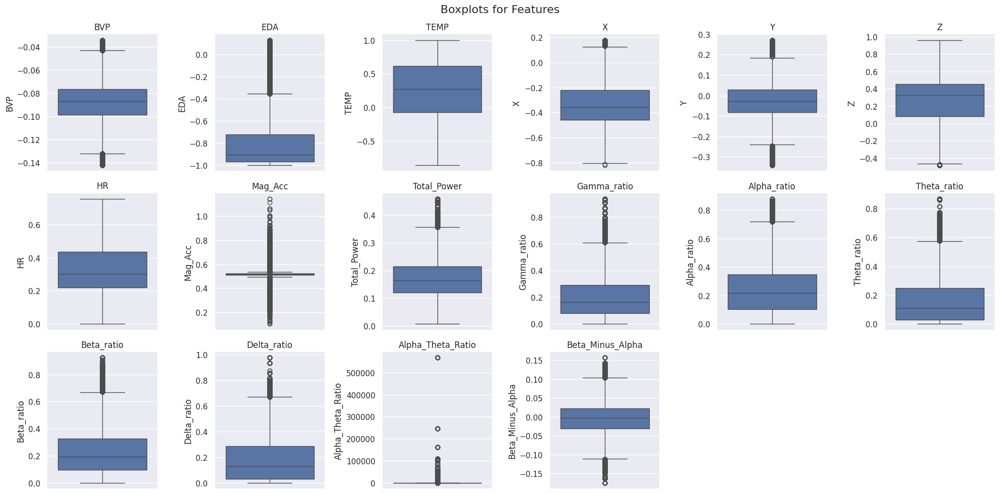

In [ ]:
feature_columns = X_engineered.columns
# Calculate the number of rows and columns for subplot grid
n_cols = 6  # You can adjust this based on how many plots you want per row
n_rows = int(np.ceil(len(feature_columns) / n_cols))

# Create a figure and an array of axes
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 10))
fig.suptitle('Boxplots for Features', fontsize=16)

# Flatten the axes array if it's 2D for easier indexing
axes = axes.flatten() if isinstance(axes, np.ndarray) else [axes]

# Plot boxplots
for i, column in enumerate(feature_columns):
    sns.boxplot(data=X_engineered[column], ax=axes[i], showfliers=True)  # showfliers=True to show outliers
    axes[i].set_title(column)
    axes[i].set_xlabel('')

# Remove unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


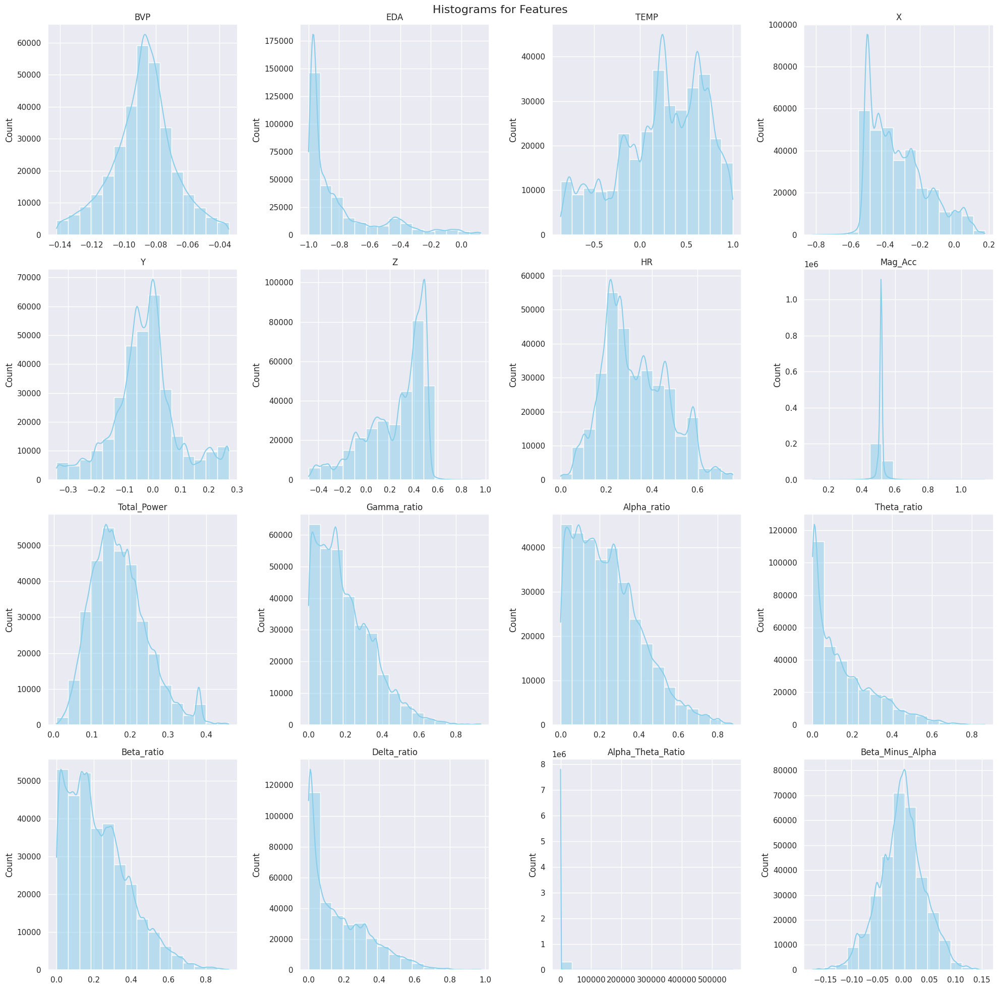

In [ ]:
n_cols = 4  # Number of columns in the subplot grid
n_rows = int(np.ceil(len(feature_columns) / n_cols))  # Calculate number of rows needed

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 5*n_rows))
fig.suptitle('Histograms for Features', fontsize=16)
axes = axes.flatten()

for i, column in enumerate(feature_columns):
    if X_engineered[column].nunique() > 1:  # Only plot if there's more than one unique value
        sns.histplot(data=X_engineered, x=column, kde=True, ax=axes[i], bins=15, color="skyblue")
        axes[i].set_title(column)
        axes[i].set_xlabel('')
    else:
        print(f"Skipping {column} as it has only one unique value.")
        fig.delaxes(axes[i])  # Remove the subplot if we can't plot

# Remove any extra subplot axes that were created but not used
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


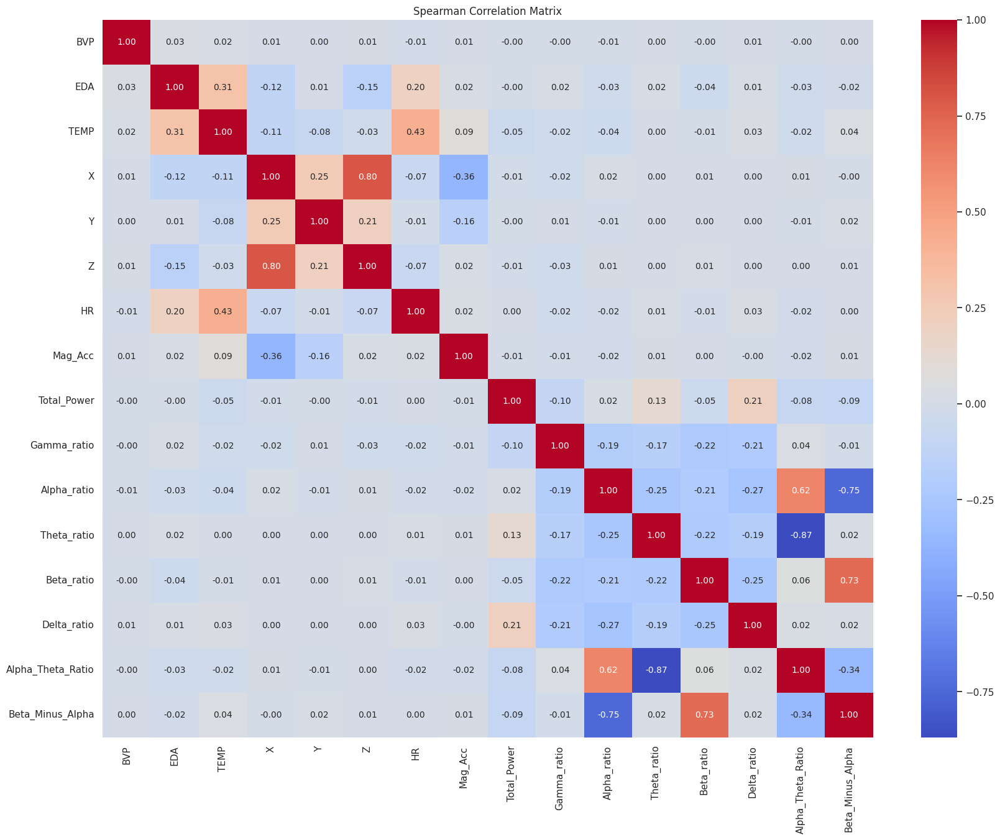

In [ ]:
# Calculate Spearman correlation matrix
corr_matrix = X_engineered.corr(method='spearman')

plt.figure(figsize=(20,15))
sns.heatmap(corr_matrix, annot=True, fmt='.2f', cmap='coolwarm', annot_kws={"size": 10})

# Add labels and title
plt.title('Spearman Correlation Matrix')
plt.show()


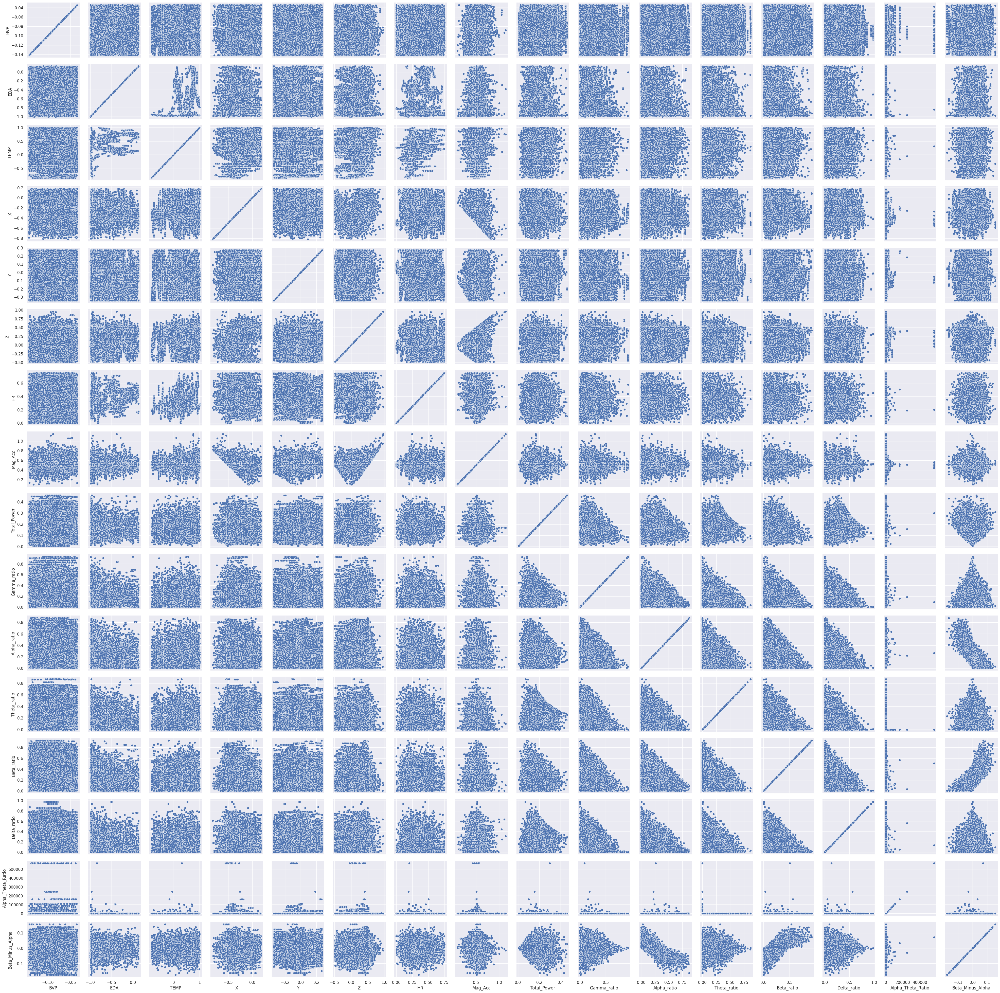

In [ ]:
# Create a grid of subplots
g = sns.PairGrid(X_engineered)

# Map the scatterplot function to each subplot
g.map(sns.scatterplot)

# Show the plot
plt.show()